**Importing Required libraries**

In [1]:
import tensorflow as tf

import os
import time

import matplotlib.pyplot as plt

**Hyperparameters for our Model**

In [2]:
BUFFER_SIZE = 400
BATCH_SIZE = 8
IMG_WIDTH = 256
IMG_HEIGHT = 256

**Path of Data**

In [3]:
# subject = 'Humans'
# subject = 'Cats'
# subject = 'Handbags'
subject = 'Shoes'
gluedPath = f'train/{subject}/'

**Load Data by splitting pixels and seperating images**

In [4]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image)

    w = tf.shape(image)[1]

    w = w // 2
    
    if subject == 'Humans':
        real_image = image[:, :w, :]
        input_image = image[:, w:, :]
    else:        
        real_image = image[:, w:, :]
        input_image = image[:, :w, :]

    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)

    return input_image, real_image

**Preprocessing Data**

In [5]:
# inp, re = load(gluedPath+'glued_human_face_60.jpg')
# # casting to int for matplotlib to show the image

# plt.figure()
# plt.imshow(inp/255.0)
# plt.figure()
# plt.imshow(re/255.0)

In [6]:
def resize(input_image, real_image, height, width):
    input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    return input_image, real_image

In [7]:
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

    return cropped_image[0], cropped_image[1]

In [8]:
# normalizing the images to [-1, 1]

def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1

    return input_image, real_image

In [9]:
@tf.function()
def random_jitter(input_image, real_image):
    # resizing to 286 x 286 x 3
    input_image, real_image = resize(input_image, real_image, 286, 286)

    # randomly cropping to 256 x 256 x 3
    input_image, real_image = random_crop(input_image, real_image)

    if tf.random.uniform(()) > 0.5:
        # random mirroring
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)

    return input_image, real_image

In [10]:
# plt.figure(figsize=(6, 6))
# for i in range(4):
#     rj_inp, rj_re = random_jitter(inp, re)
#     plt.subplot(2, 2, i+1),
#     plt.imshow(rj_inp/255.0)
#     plt.axis('off')
# plt.show()

In [11]:
def load_image_train(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [12]:
def load_image_test(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [13]:
train_dataset = tf.data.Dataset.list_files(gluedPath+'*.jpg')
train_dataset = train_dataset.map(load_image_train)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [14]:
test_dataset = tf.data.Dataset.list_files(f'test/{subject}/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [15]:
OUTPUT_CHANNELS = 3

**Model Architecture**

In [16]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [17]:
# down_model = downsample(3, 4)
# down_result = down_model(tf.expand_dims(inp, 0))
# print (down_result.shape)

In [18]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                                padding='same',
                                                kernel_initializer=initializer,
                                                use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [19]:
# up_model = upsample(3, 4)
# up_result = up_model(down_result)
# print (up_result.shape)

**Generator**

In [20]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[256,256,3])

    down_stack = [
                downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
                downsample(128, 4), # (bs, 64, 64, 128)
                downsample(256, 4), # (bs, 32, 32, 256)
                downsample(512, 4), # (bs, 16, 16, 512)
                downsample(512, 4), # (bs, 8, 8, 512)
                downsample(512, 4), # (bs, 4, 4, 512)
                downsample(512, 4), # (bs, 2, 2, 512)
                downsample(512, 4), # (bs, 1, 1, 512)
                ]

    up_stack = [
                upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
                upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
                upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
                upsample(512, 4), # (bs, 16, 16, 1024)
                upsample(256, 4), # (bs, 32, 32, 512)
                upsample(128, 4), # (bs, 64, 64, 256)
                upsample(64, 4), # (bs, 128, 128, 128)
                ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [21]:

#If you want to start a new Generator model use this code

generator = Generator()

#If you want to load your previous generator model you can with the following code. 
#By loading it you will be able to continue training it!

# generator = tf.keras.models.load_model("saved_model/humans_fully_trained.h5")


In [22]:
# gen_output = generator(inp[tf.newaxis,...], training=False)
# plt.imshow(gen_output[0,...])

In [23]:
LAMBDA = 100

In [24]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

**Discriminator**

In [25]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

    down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [26]:
discriminator = Discriminator()
# tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [27]:
# disc_out = discriminator([inp[tf.newaxis,...], gen_output], training=False)
# plt.imshow(disc_out[0,...,-1], vmin=-20, vmax=20, cmap='RdBu_r')
# plt.colorbar()

In [28]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [29]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

**Hyperparameters for our models, feel free to tweak these for varying results**

In [30]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [31]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

**Generate Images Function**

In [32]:
def generate_images(model, test_input, tar, epoch):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15,15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
        
        if epoch >= 0:
            plt.savefig(f'generated_images/{subject}/{epoch}.png')
            
    plt.show()

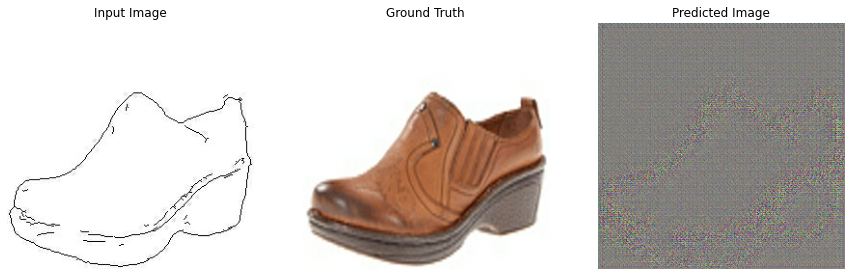

In [33]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target, epoch=-1)

**Training Phase**

In [34]:
#Change this to whatever you want, normally more epochs = better model ( but be careful of overfitting *)
EPOCHS = 150

In [35]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
    log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [36]:
@tf.function
def train_step(input_image, target, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
        
    generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [37]:
def fit(train_ds, epochs, test_ds):
    for epoch in range(epochs):
        start = time.time()

        #     display.clear_output(wait=True)

        for example_input, example_target in test_ds.take(1):
            generate_images(generator, example_input, example_target, epoch)
        print("Epoch: ", epoch)

        # Train
        for n, (input_image, target) in train_ds.enumerate():
            print('.', end='')
            if (n+1) % 100 == 0:
                print()
            train_step(input_image, target, epoch)
        print()

        # saving (checkpoint) the model every 20 epochs
        if (epoch + 1) % 20 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)

        print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
    checkpoint.save(file_prefix = checkpoint_prefix)

**Training the Model**

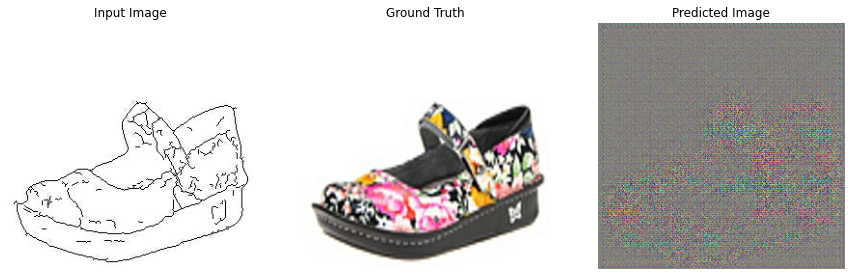

Epoch:  0
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 1 is 111.43228960037231 sec



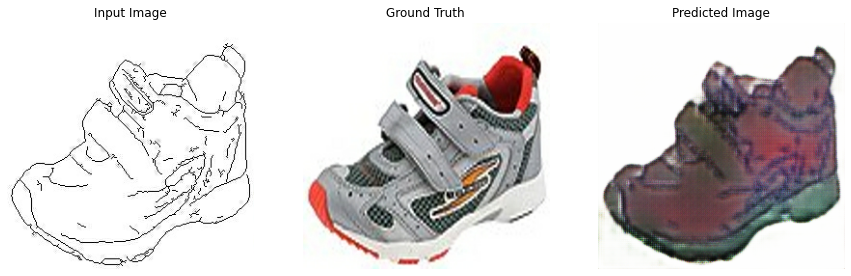

Epoch:  1
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 2 is 108.34574151039124 sec



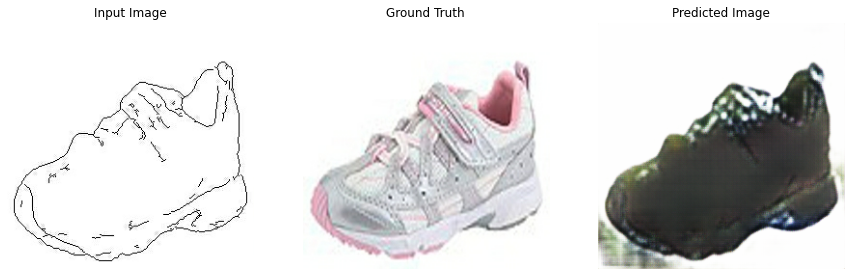

Epoch:  2
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 3 is 108.51403832435608 sec



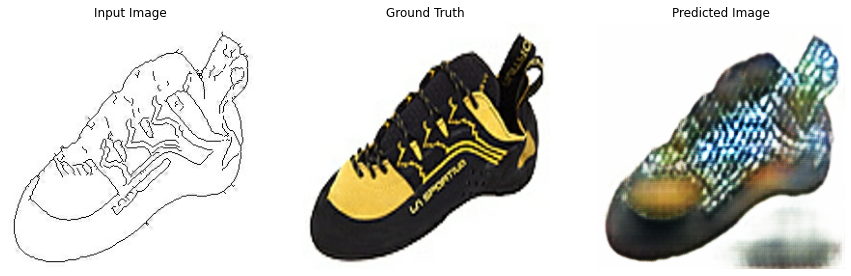

Epoch:  3
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 4 is 109.76752209663391 sec



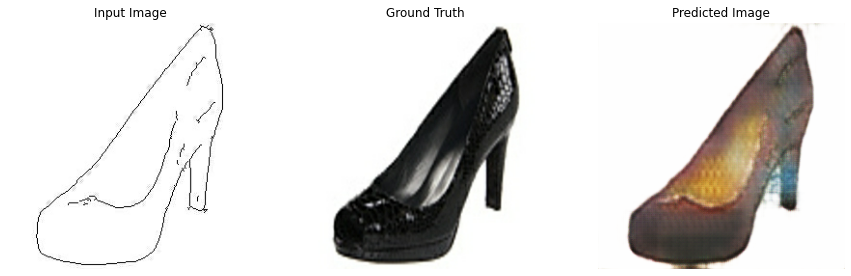

Epoch:  4
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 5 is 109.39259052276611 sec



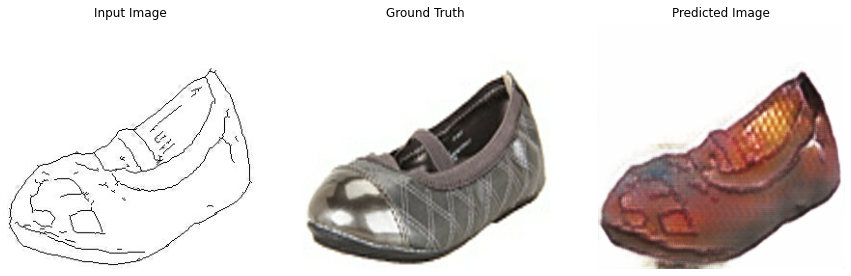

Epoch:  5
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 6 is 107.62667107582092 sec



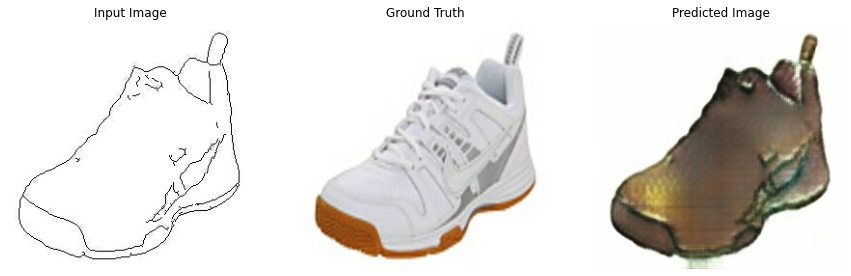

Epoch:  6
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 7 is 107.92941975593567 sec



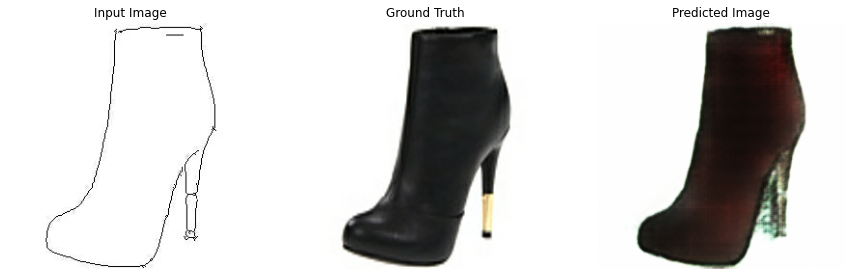

Epoch:  7
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 8 is 108.08159279823303 sec



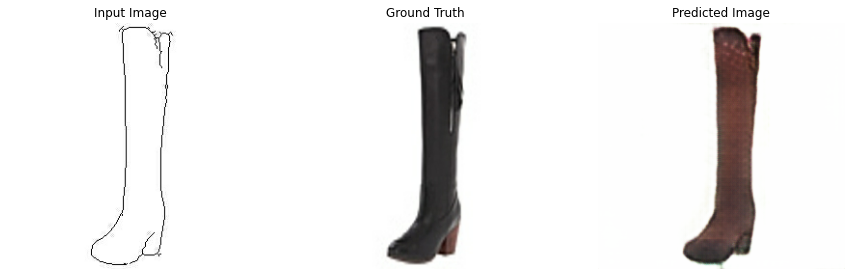

Epoch:  8
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 9 is 107.76591658592224 sec



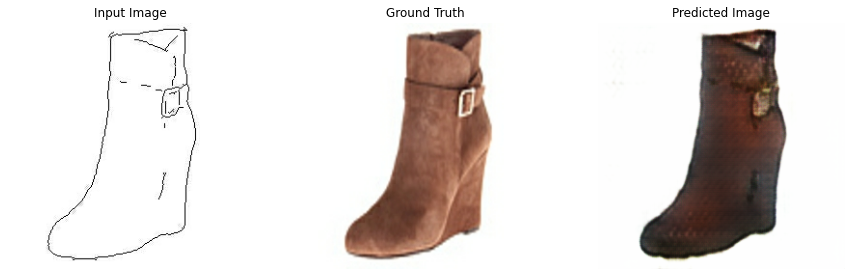

Epoch:  9
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 10 is 108.06768536567688 sec



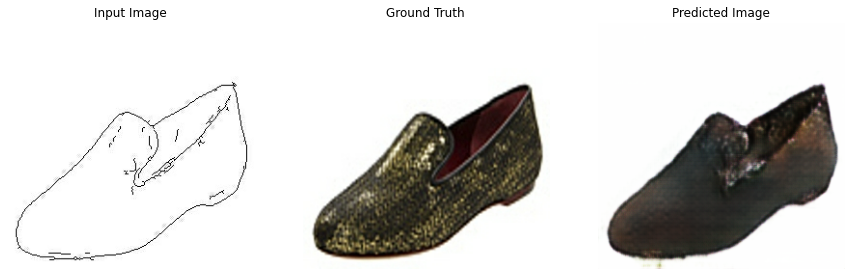

Epoch:  10
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 11 is 107.73241972923279 sec



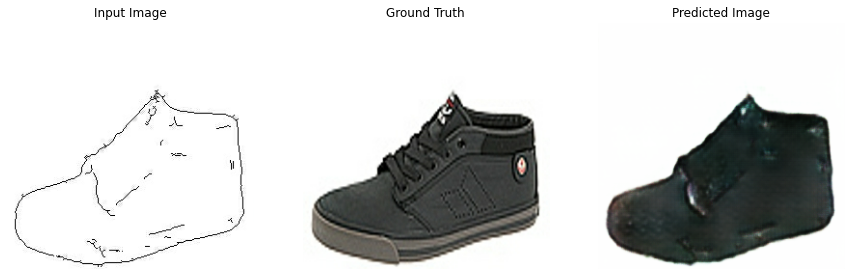

Epoch:  11
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 12 is 108.0807626247406 sec



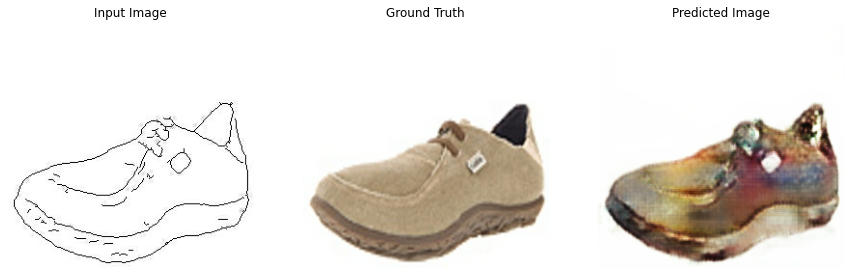

Epoch:  12
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 13 is 107.84154987335205 sec



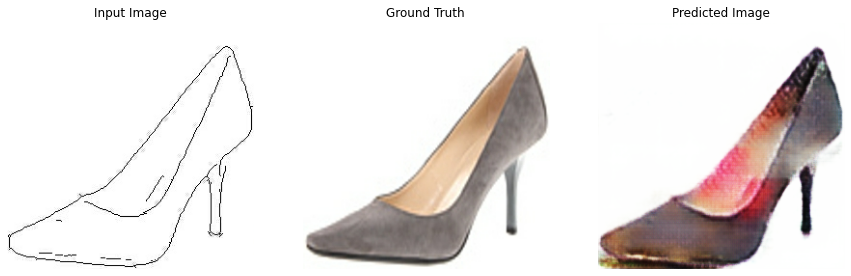

Epoch:  13
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 14 is 107.89948749542236 sec



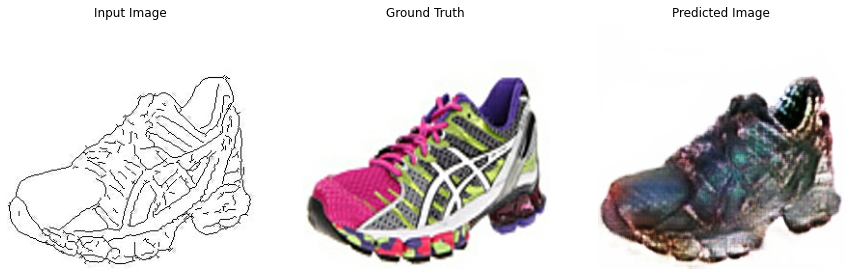

Epoch:  14
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 15 is 107.99205279350281 sec



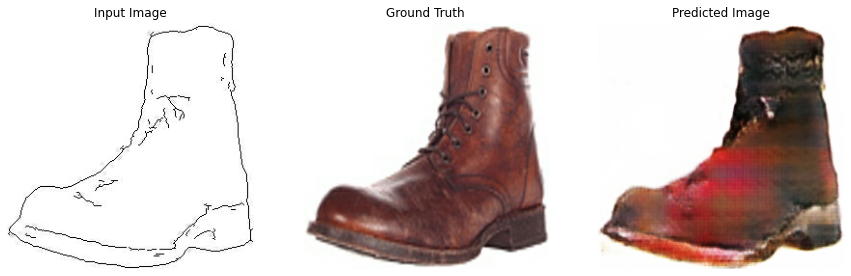

Epoch:  15
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 16 is 107.68601942062378 sec



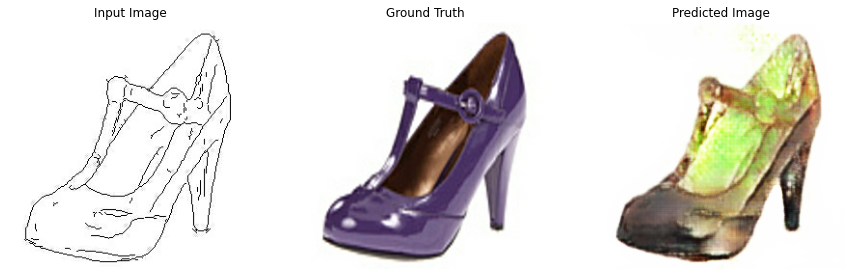

Epoch:  16
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 17 is 107.6522388458252 sec



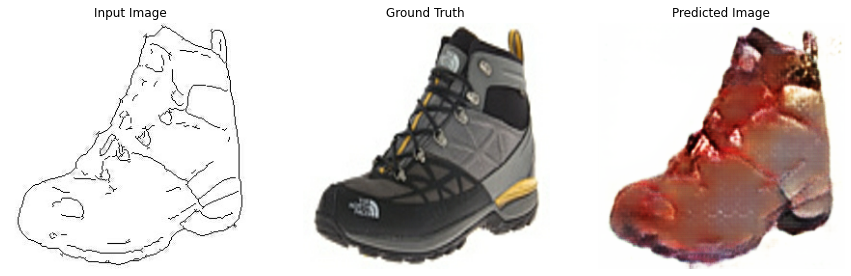

Epoch:  17
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 18 is 107.62767672538757 sec



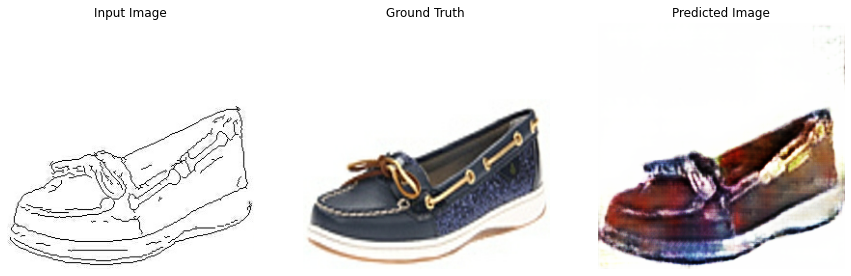

Epoch:  18
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 19 is 107.69830179214478 sec



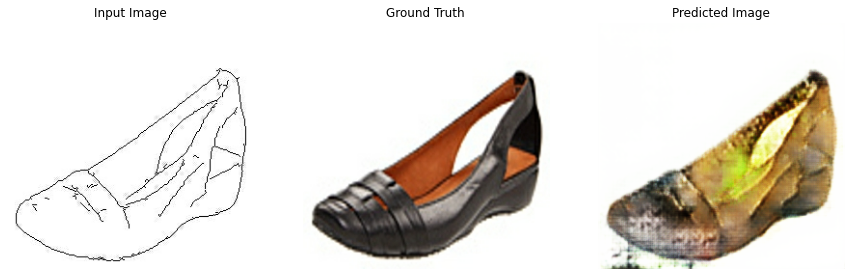

Epoch:  19
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 20 is 110.5768392086029 sec



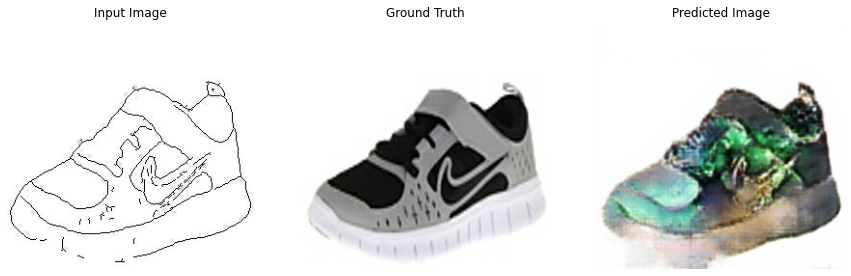

Epoch:  20
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 21 is 107.82123613357544 sec



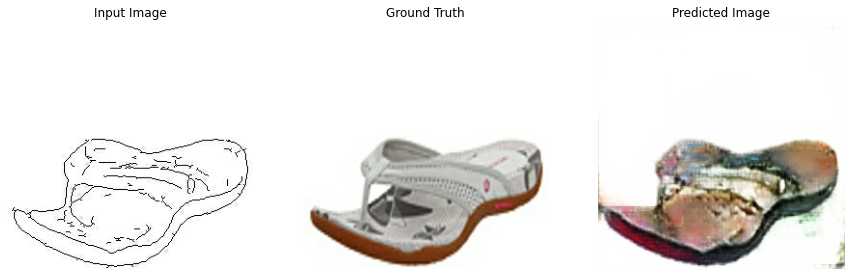

Epoch:  21
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 22 is 107.64897108078003 sec



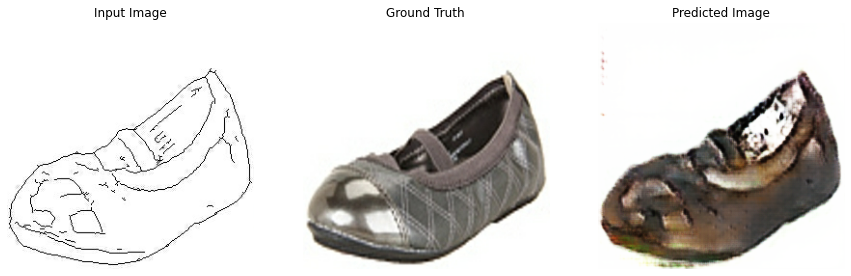

Epoch:  22
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 23 is 107.4546263217926 sec



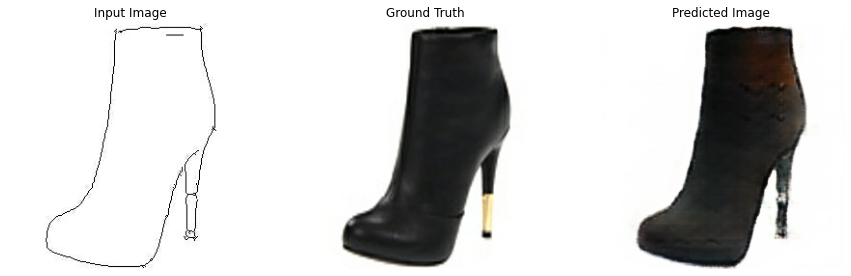

Epoch:  23
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 24 is 107.83880186080933 sec



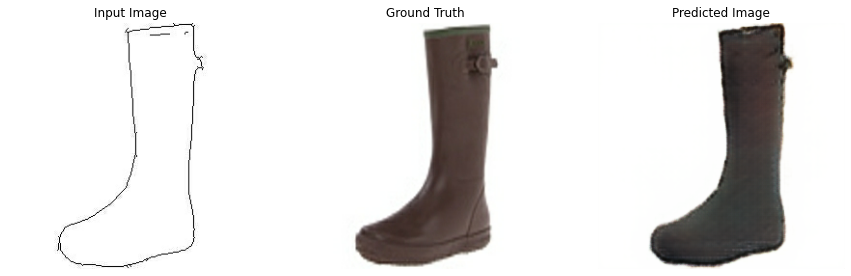

Epoch:  24
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 25 is 107.91936182975769 sec



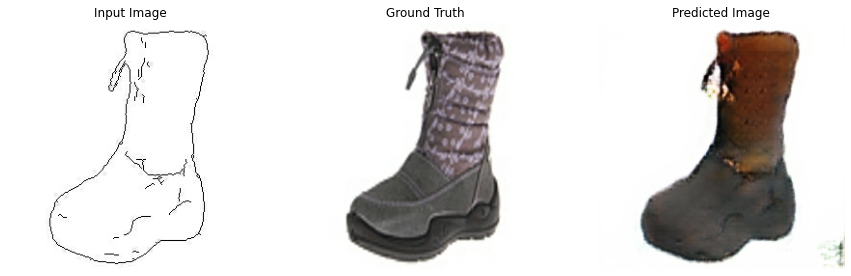

Epoch:  25
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 26 is 108.24623203277588 sec



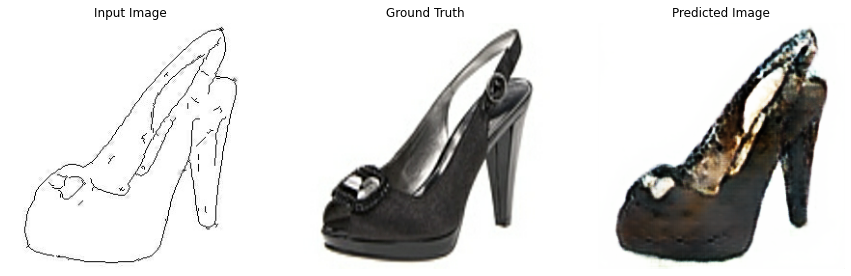

Epoch:  26
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 27 is 108.00051879882812 sec



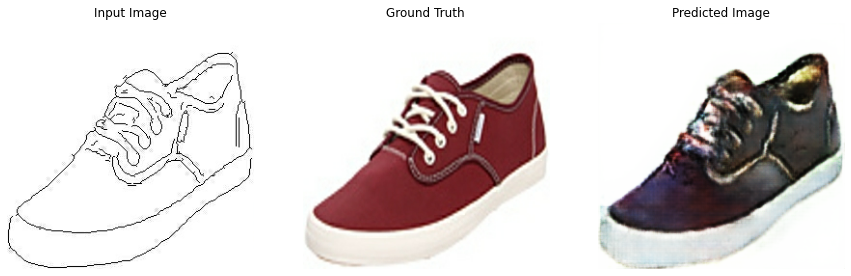

Epoch:  27
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 28 is 108.02169895172119 sec



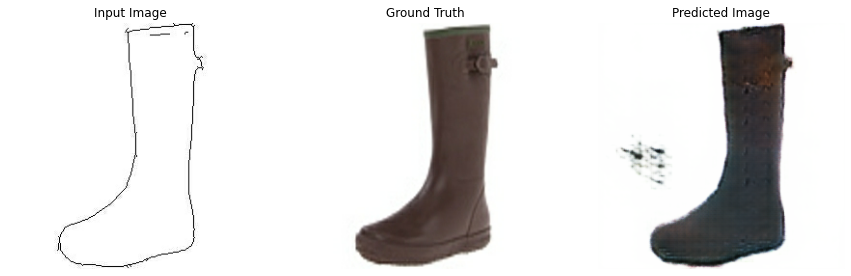

Epoch:  28
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 29 is 107.78706789016724 sec



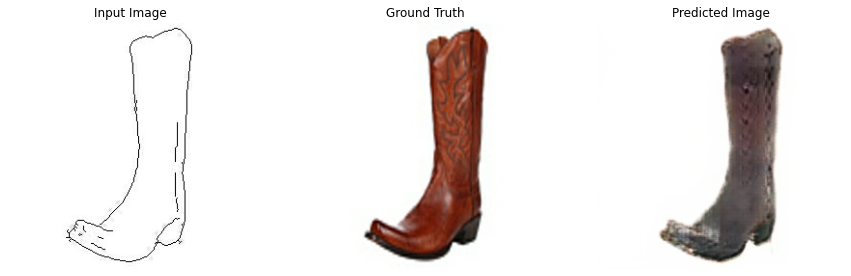

Epoch:  29
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 30 is 107.94039273262024 sec



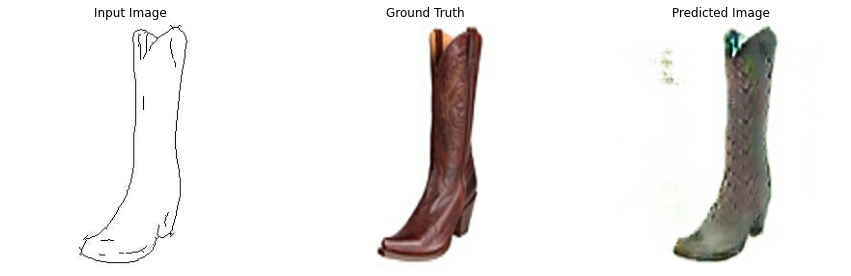

Epoch:  30
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 31 is 107.69422817230225 sec



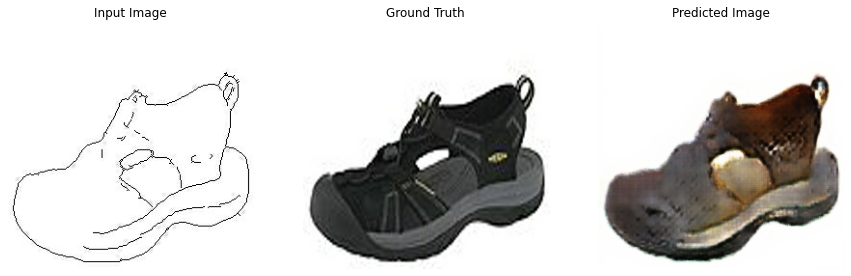

Epoch:  31
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 32 is 107.93429684638977 sec



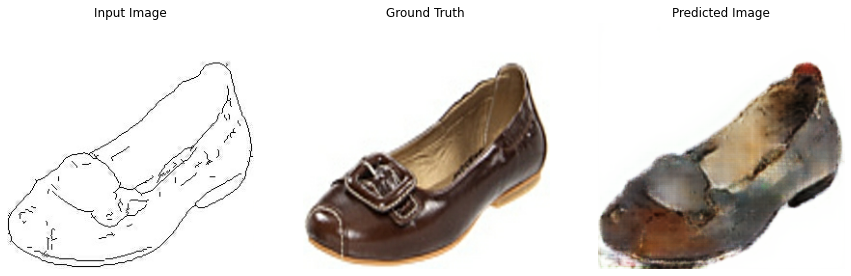

Epoch:  32
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 33 is 108.12716817855835 sec



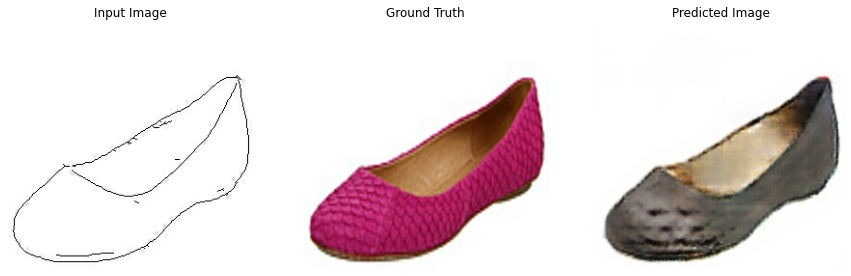

Epoch:  33
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 34 is 107.60525751113892 sec



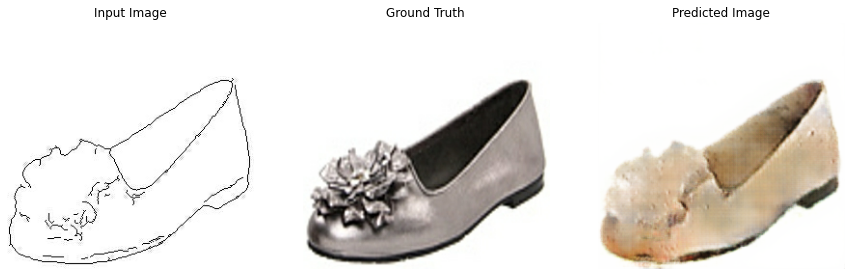

Epoch:  34
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 35 is 108.41722512245178 sec



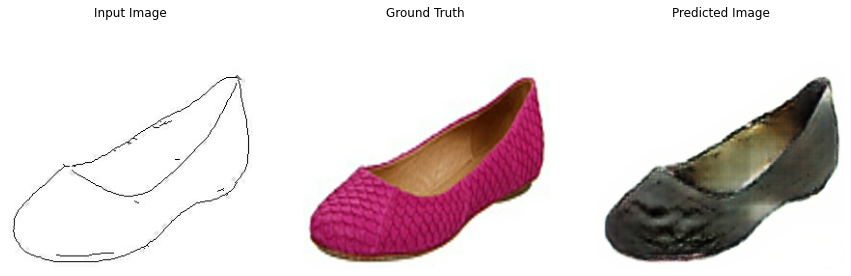

Epoch:  35
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 36 is 108.14149641990662 sec



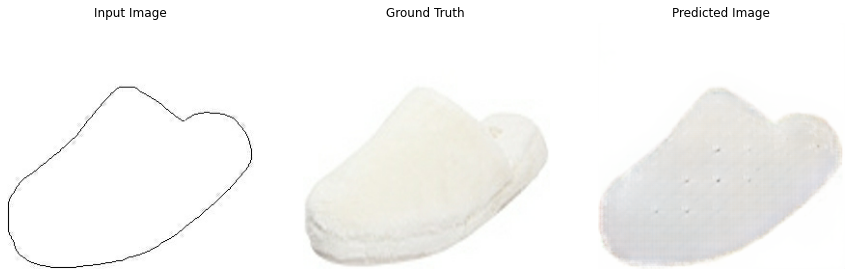

Epoch:  36
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 37 is 108.18871808052063 sec



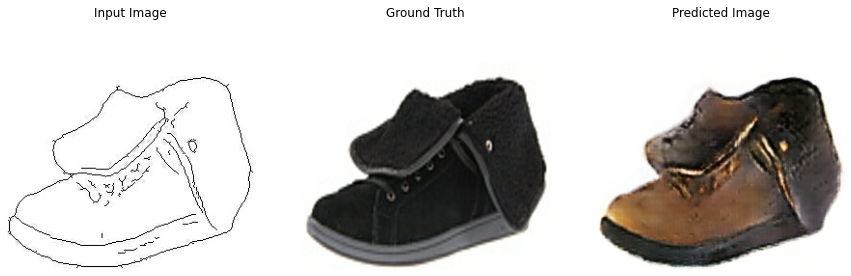

Epoch:  37
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 38 is 107.76722145080566 sec



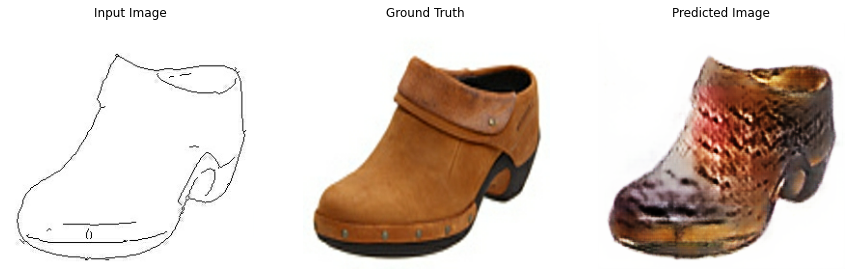

Epoch:  38
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 39 is 107.96232223510742 sec



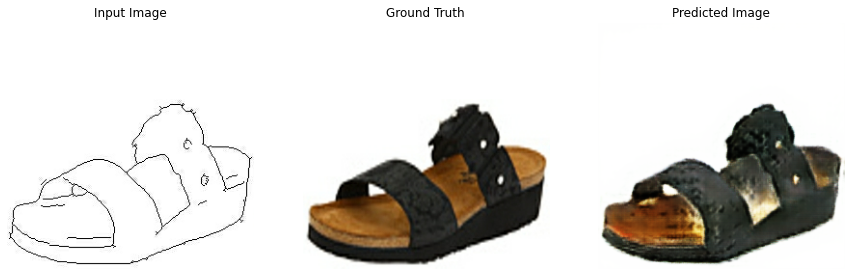

Epoch:  39
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 40 is 110.64465713500977 sec



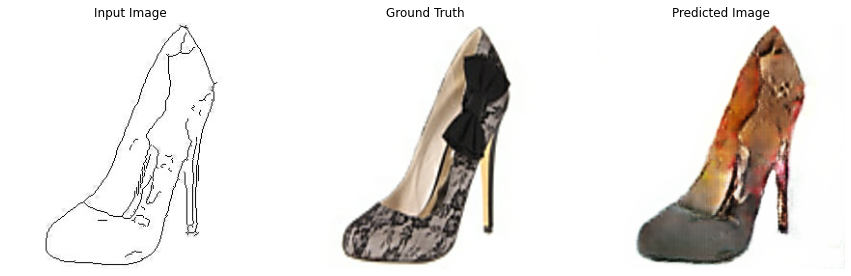

Epoch:  40
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 41 is 108.0308346748352 sec



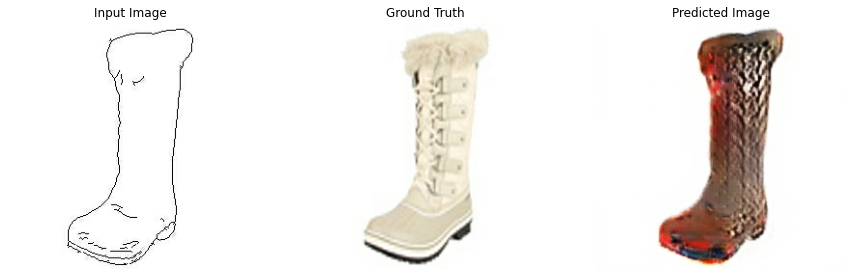

Epoch:  41
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 42 is 107.68194103240967 sec



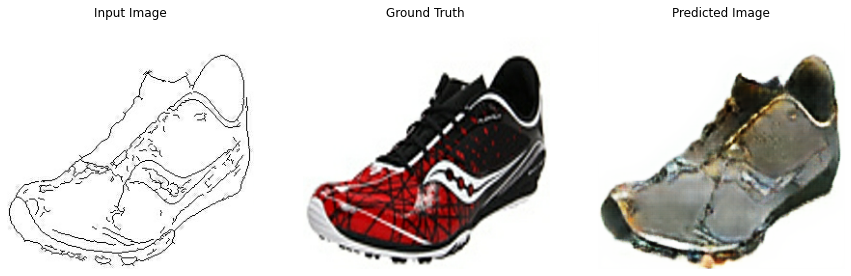

Epoch:  42
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 43 is 107.97142148017883 sec



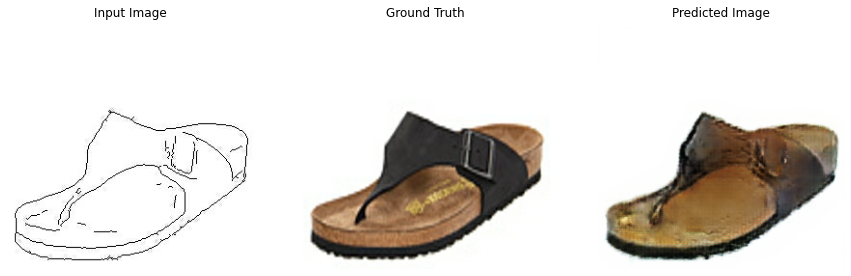

Epoch:  43
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 44 is 107.88014888763428 sec



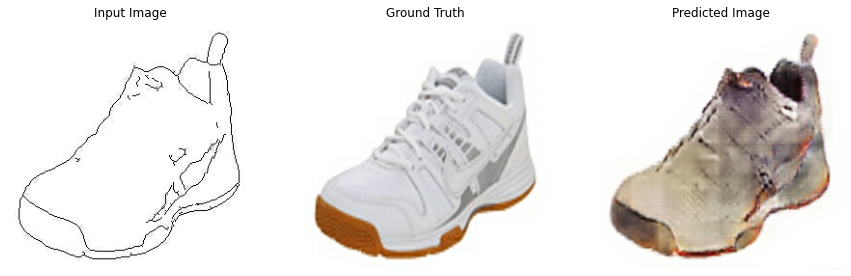

Epoch:  44
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 45 is 108.277902841568 sec



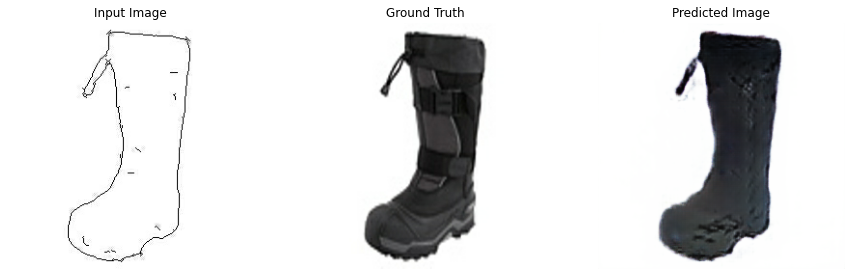

Epoch:  45
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 46 is 108.23419547080994 sec



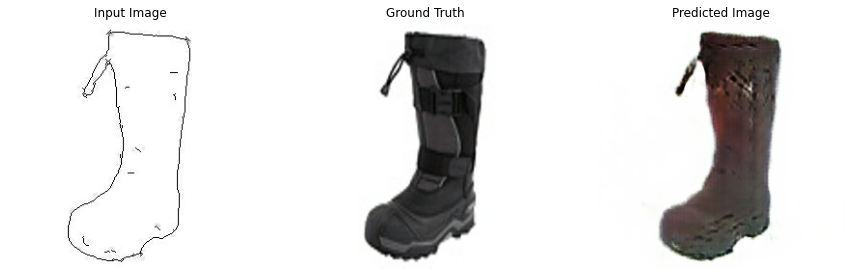

Epoch:  46
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 47 is 107.72509741783142 sec



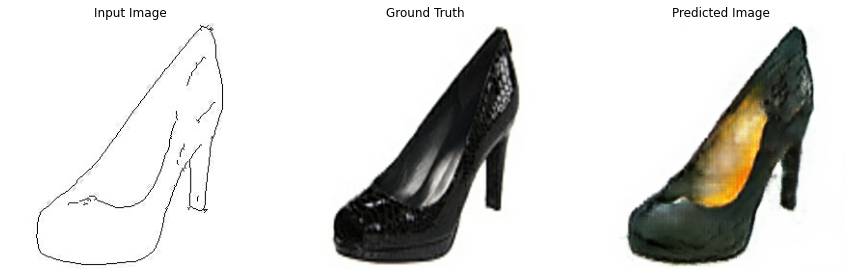

Epoch:  47
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 48 is 108.26273369789124 sec



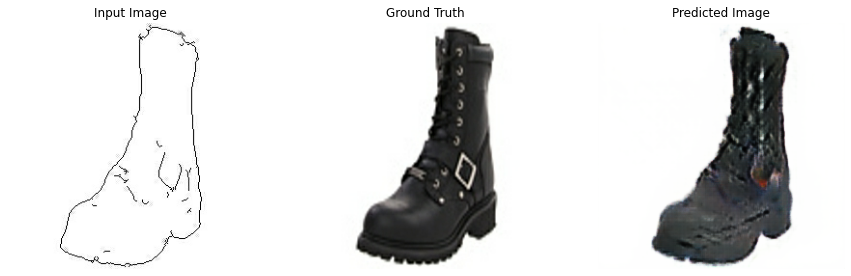

Epoch:  48
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 49 is 108.58964347839355 sec



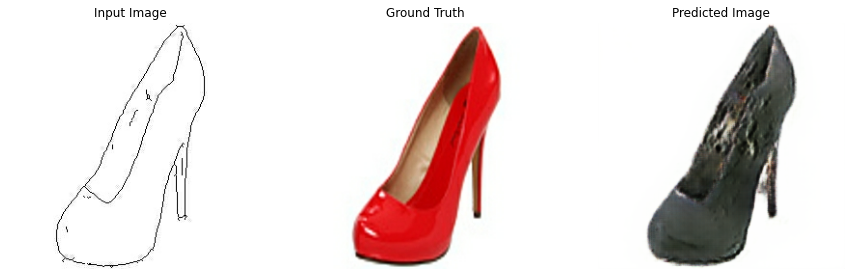

Epoch:  49
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 50 is 108.5320794582367 sec



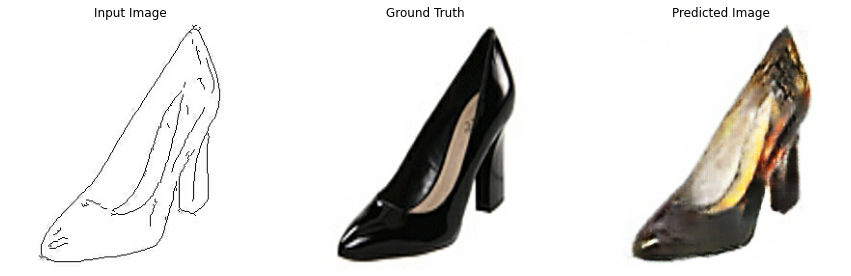

Epoch:  50
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 51 is 108.08393955230713 sec



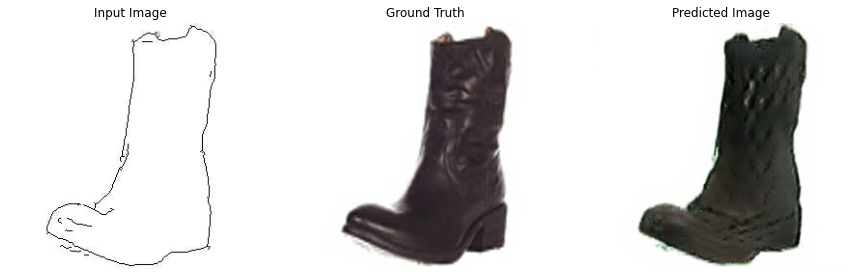

Epoch:  51
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 52 is 108.0338065624237 sec



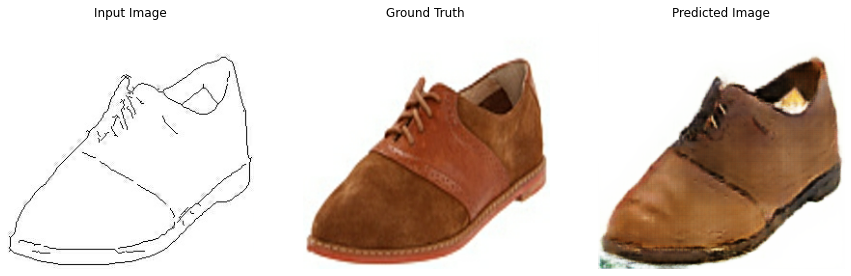

Epoch:  52
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 53 is 107.81660604476929 sec



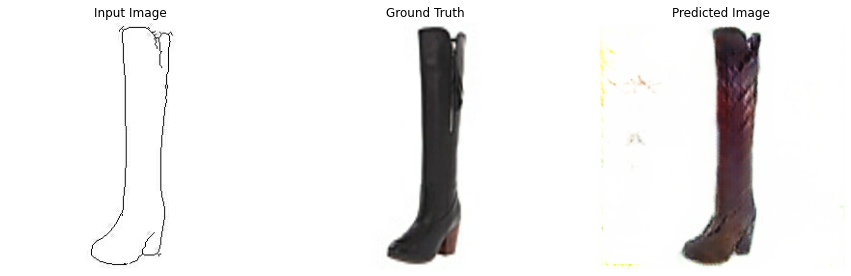

Epoch:  53
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 54 is 108.03414344787598 sec



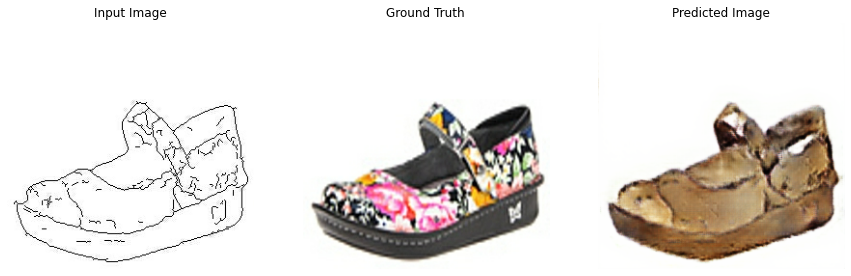

Epoch:  54
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 55 is 108.2286765575409 sec



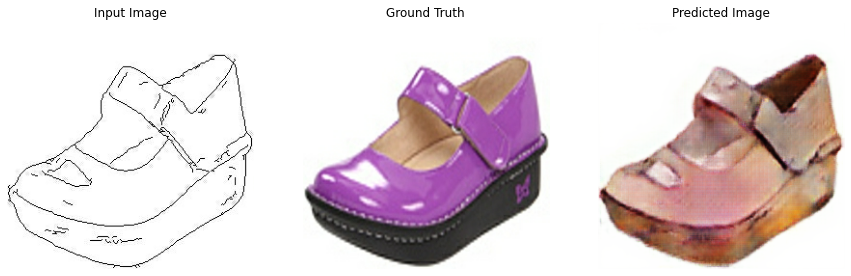

Epoch:  55
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 56 is 108.13255023956299 sec



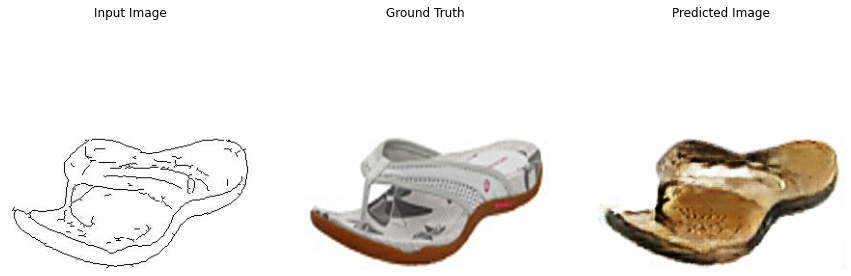

Epoch:  56
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 57 is 108.17250299453735 sec



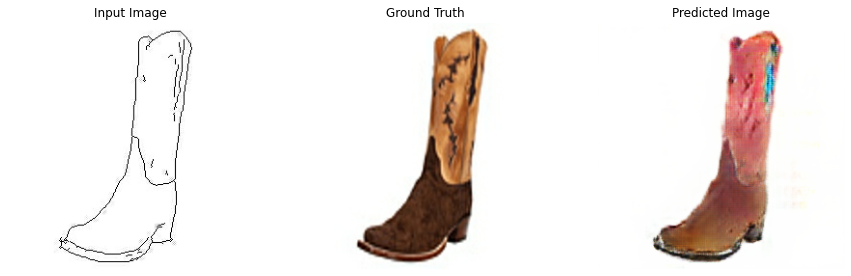

Epoch:  57
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 58 is 108.01851987838745 sec



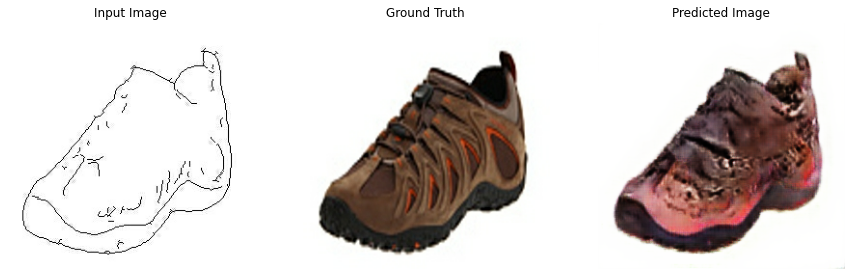

Epoch:  58
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 59 is 108.1521348953247 sec



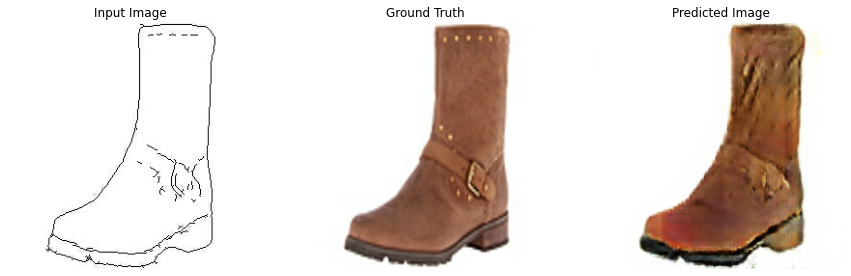

Epoch:  59
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 60 is 110.60812640190125 sec



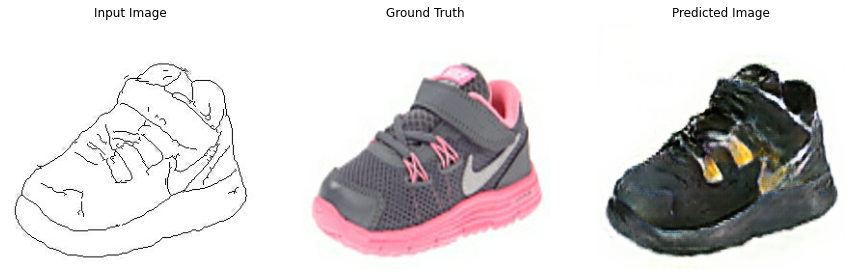

Epoch:  60
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 61 is 108.05080366134644 sec



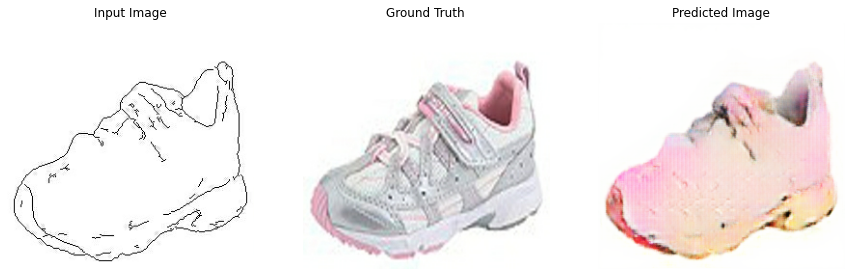

Epoch:  61
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 62 is 108.34524846076965 sec



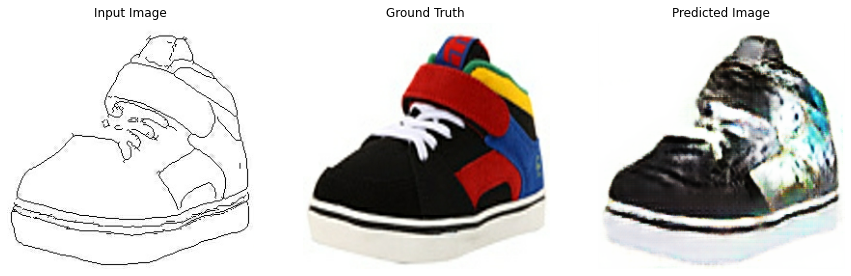

Epoch:  62
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 63 is 107.93386006355286 sec



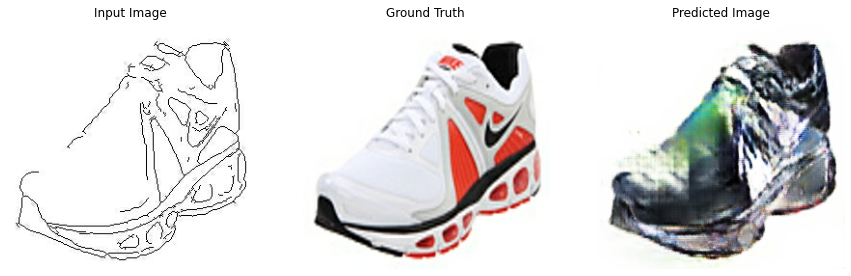

Epoch:  63
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 64 is 107.86666655540466 sec



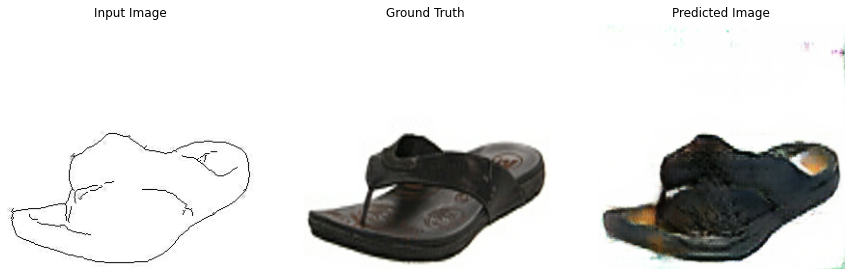

Epoch:  64
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 65 is 107.94637036323547 sec



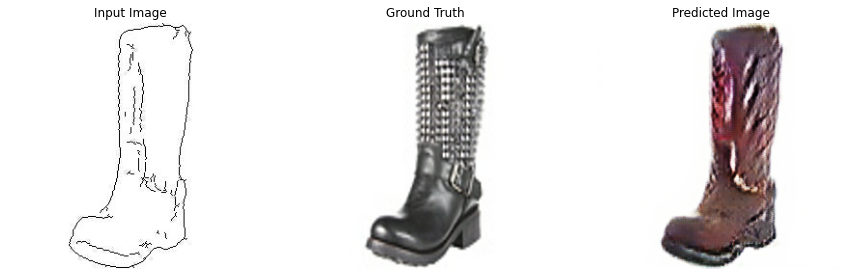

Epoch:  65
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 66 is 108.00776386260986 sec



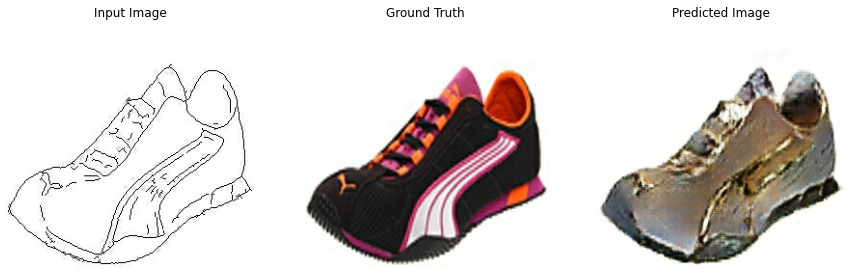

Epoch:  66
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 67 is 108.44916534423828 sec



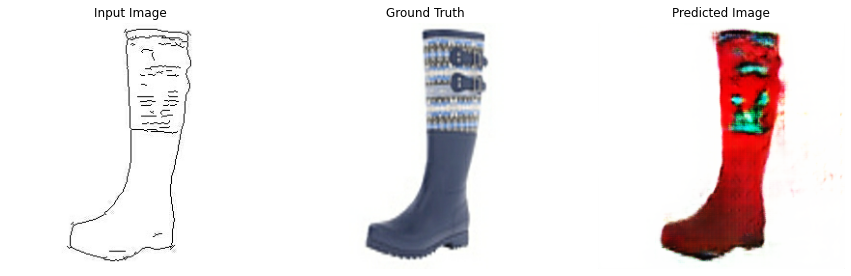

Epoch:  67
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 68 is 108.15244817733765 sec



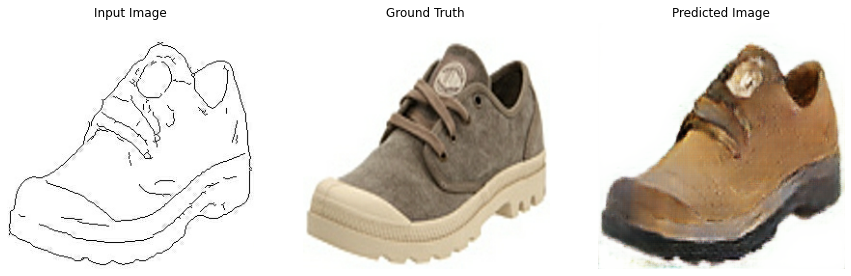

Epoch:  68
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 69 is 107.9569160938263 sec



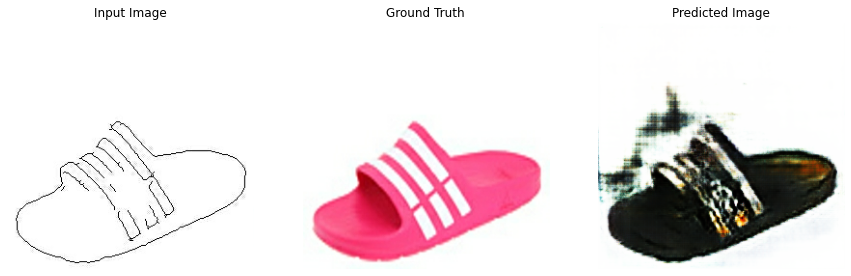

Epoch:  69
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 70 is 107.86774897575378 sec



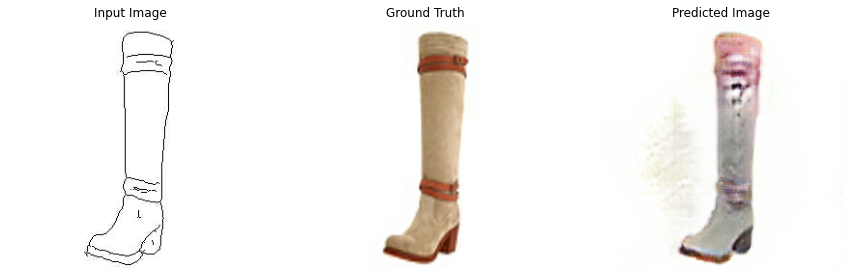

Epoch:  70
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 71 is 108.26121091842651 sec



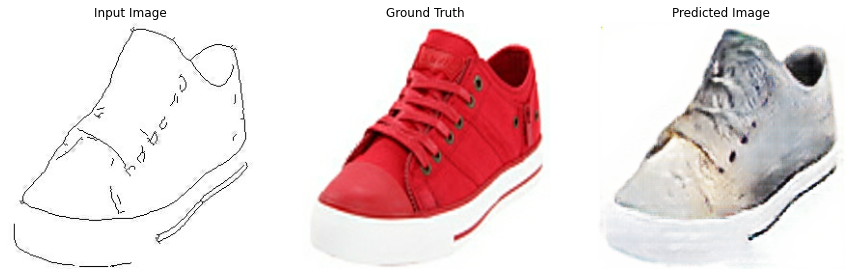

Epoch:  71
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 72 is 108.16993951797485 sec



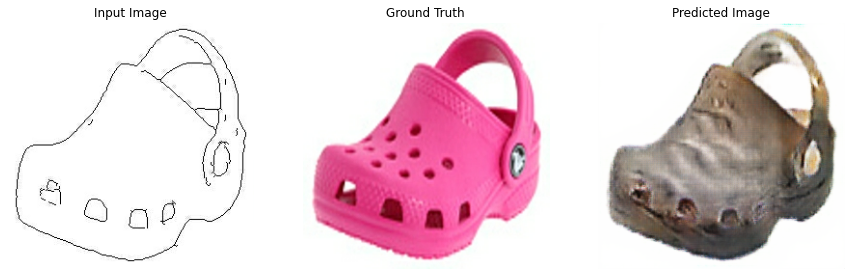

Epoch:  72
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 73 is 108.3894464969635 sec



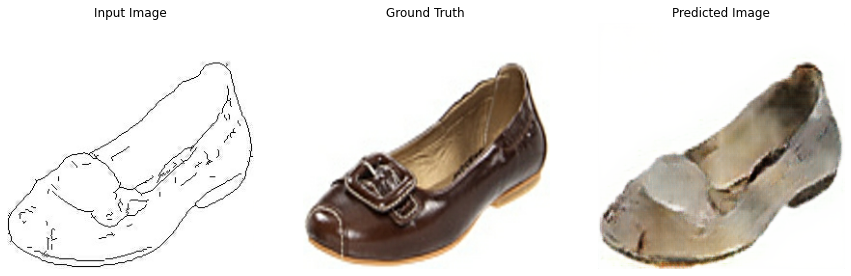

Epoch:  73
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 74 is 108.23632335662842 sec



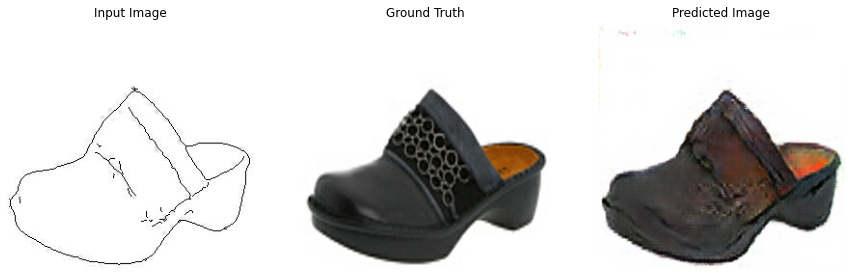

Epoch:  74
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 75 is 107.93750834465027 sec



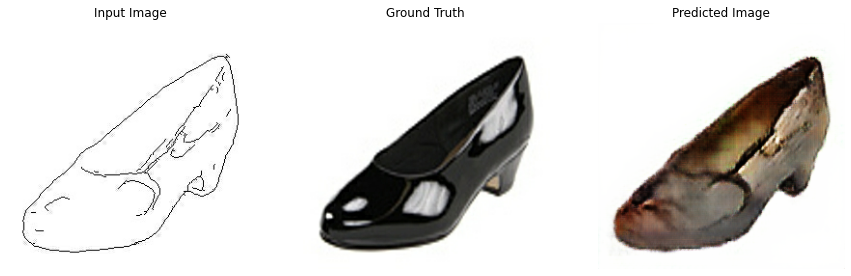

Epoch:  75
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 76 is 108.00469517707825 sec



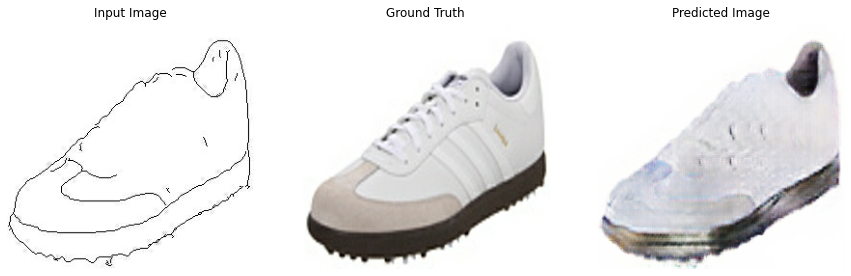

Epoch:  76
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 77 is 108.31020474433899 sec



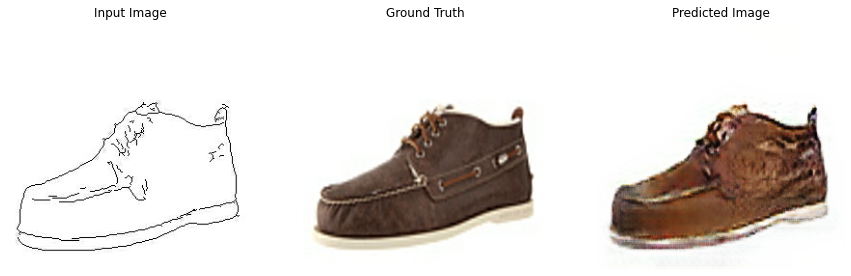

Epoch:  77
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 78 is 108.17642974853516 sec



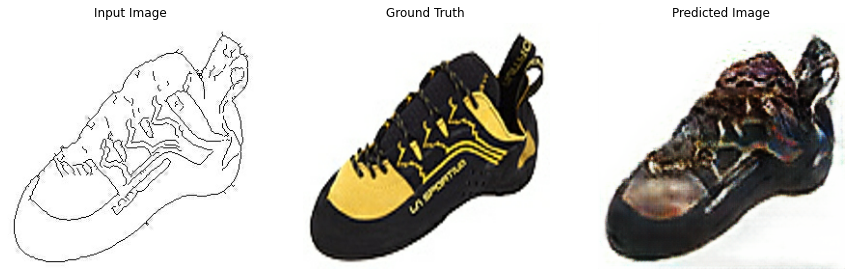

Epoch:  78
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 79 is 107.98217749595642 sec



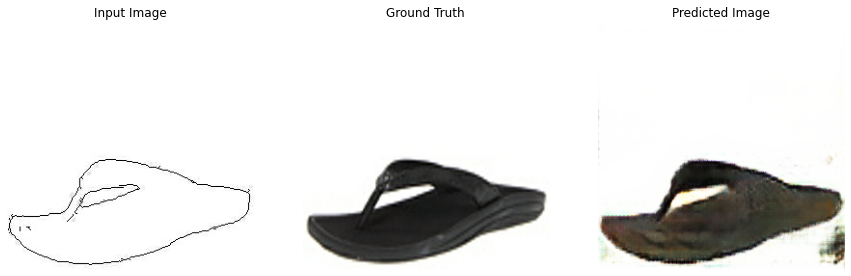

Epoch:  79
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 80 is 110.84009838104248 sec



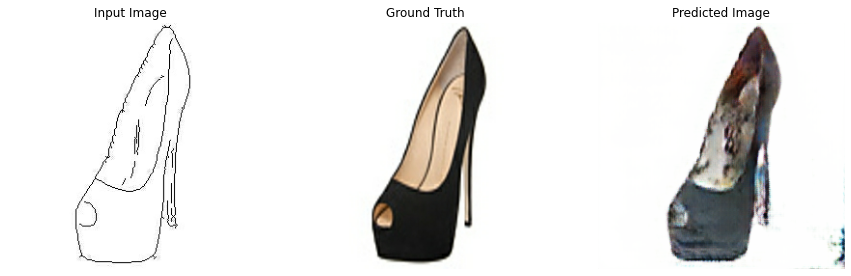

Epoch:  80
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 81 is 107.93047165870667 sec



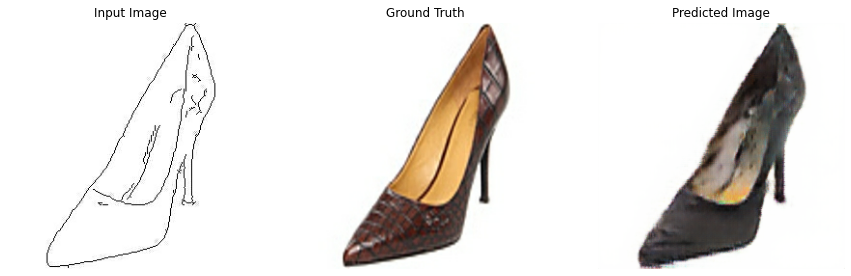

Epoch:  81
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 82 is 108.27427291870117 sec



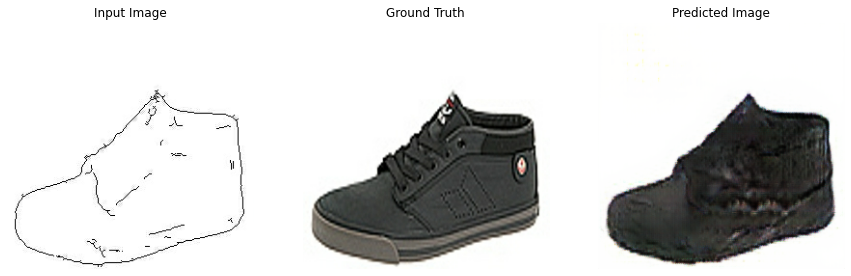

Epoch:  82
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 83 is 107.92016458511353 sec



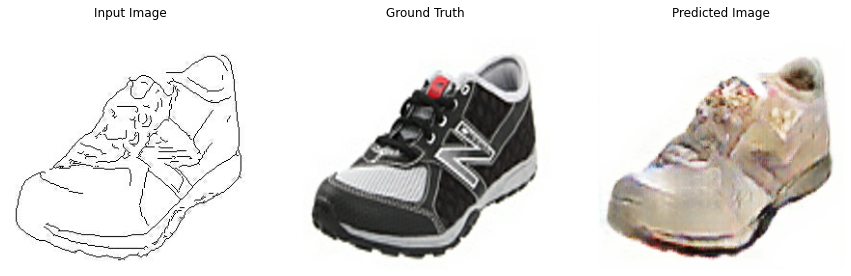

Epoch:  83
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 84 is 108.33307456970215 sec



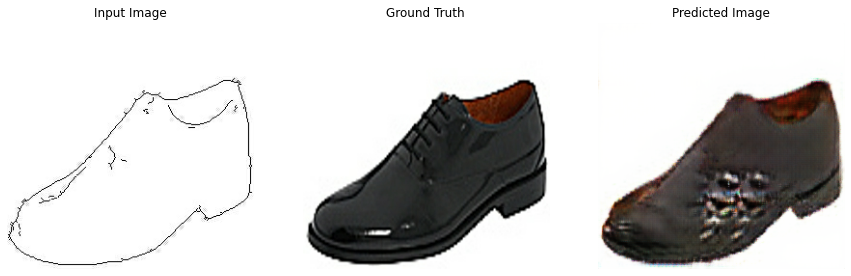

Epoch:  84
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 85 is 108.67366313934326 sec



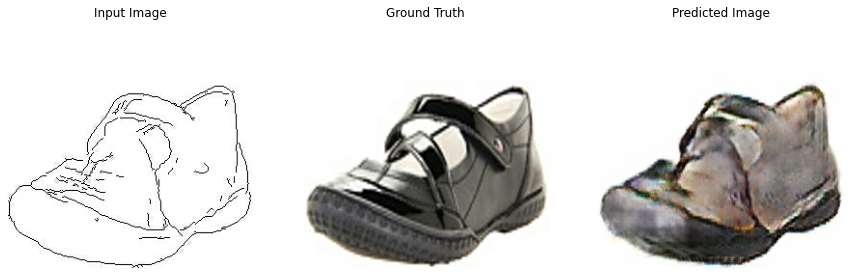

Epoch:  85
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 86 is 108.22380375862122 sec



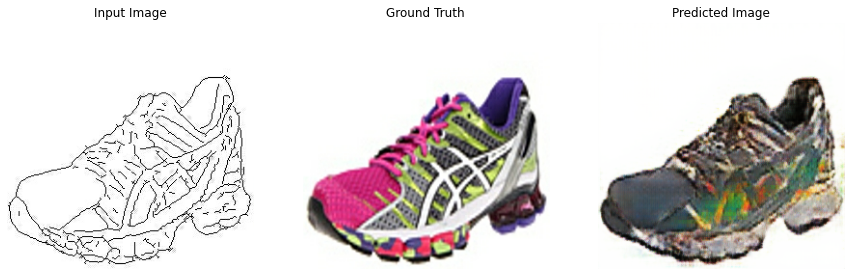

Epoch:  86
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 87 is 108.15715861320496 sec



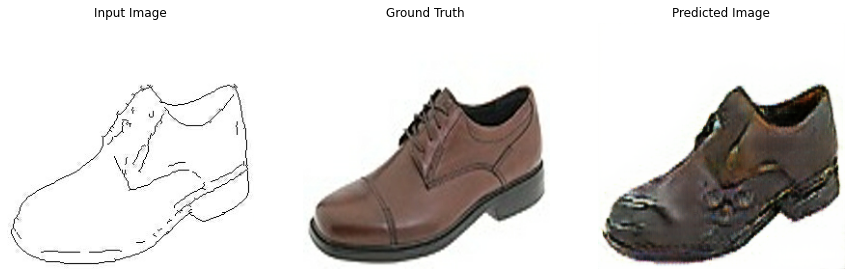

Epoch:  87
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 88 is 108.013751745224 sec



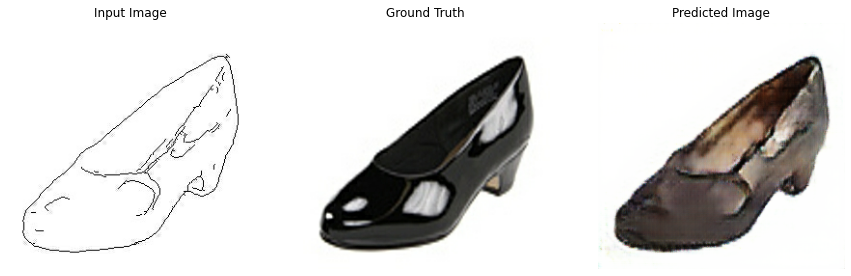

Epoch:  88
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 89 is 108.44854259490967 sec



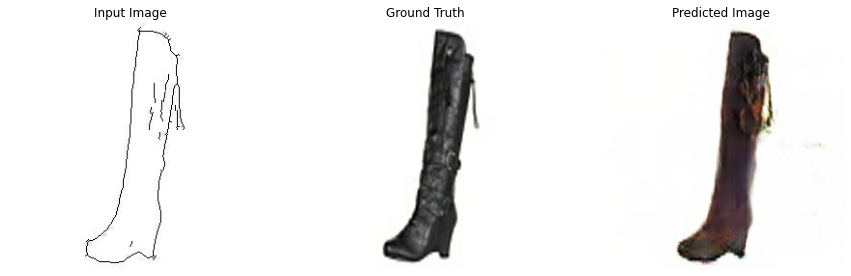

Epoch:  89
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 90 is 108.10867929458618 sec



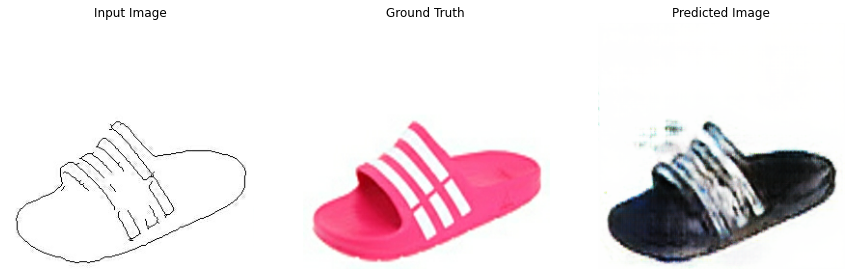

Epoch:  90
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 91 is 108.28778672218323 sec



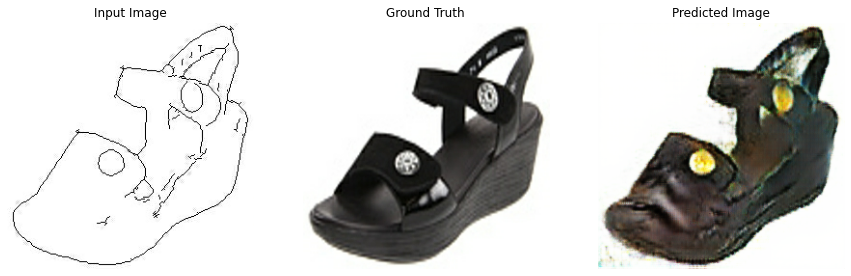

Epoch:  91
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 92 is 108.25605797767639 sec



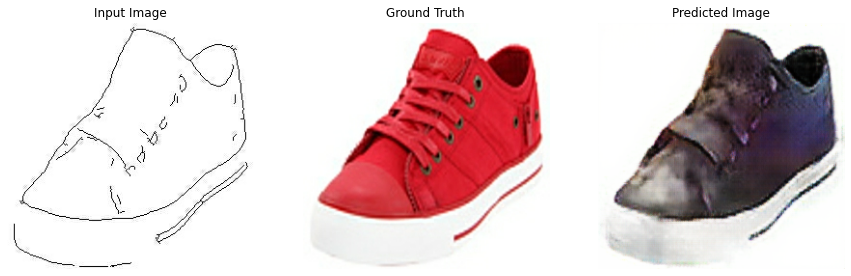

Epoch:  92
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 93 is 108.43451404571533 sec



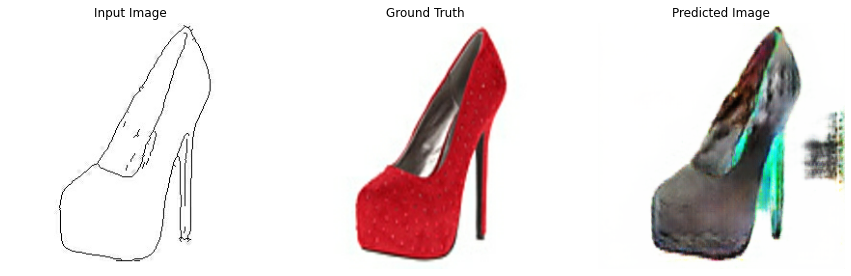

Epoch:  93
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 94 is 106.81188488006592 sec



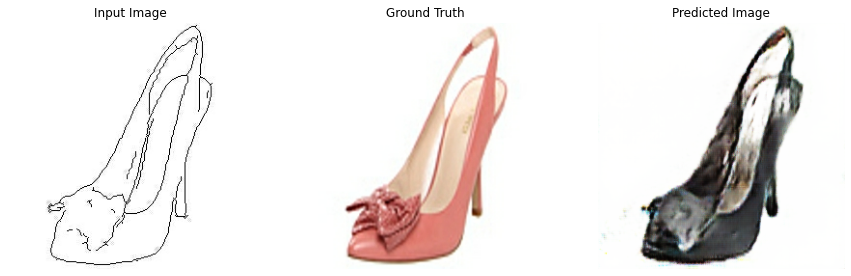

Epoch:  94
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 95 is 107.21546792984009 sec



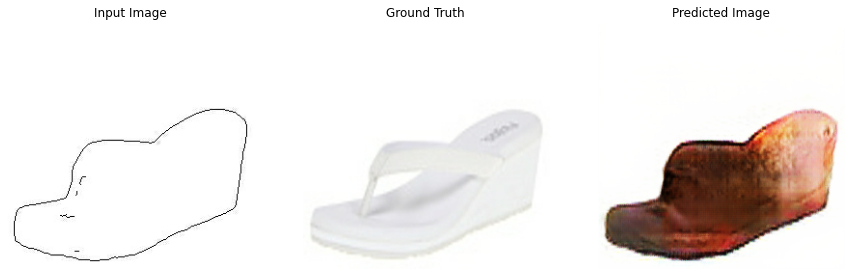

Epoch:  95
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 96 is 108.0264036655426 sec



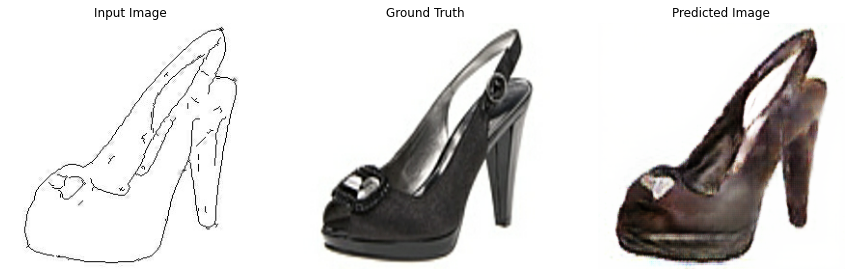

Epoch:  96
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 97 is 108.07201862335205 sec



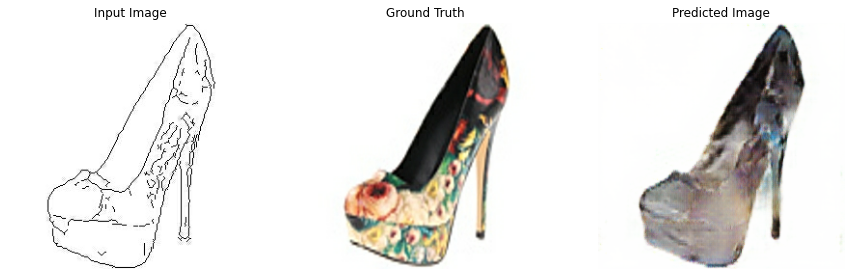

Epoch:  97
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 98 is 107.9477026462555 sec



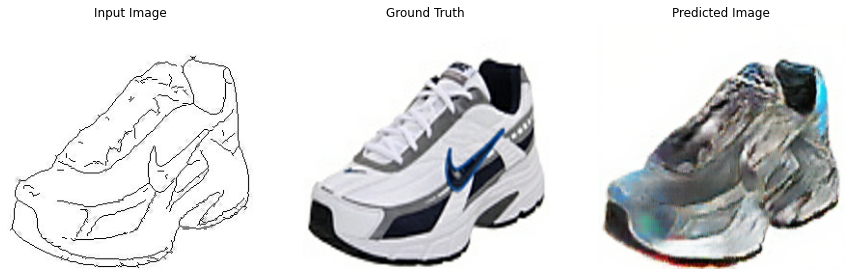

Epoch:  98
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 99 is 108.43806028366089 sec



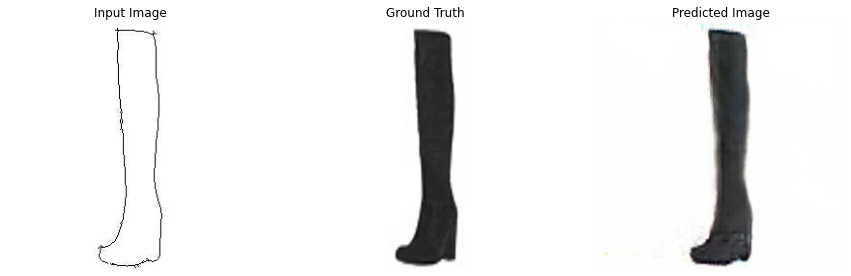

Epoch:  99
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 100 is 110.78893804550171 sec



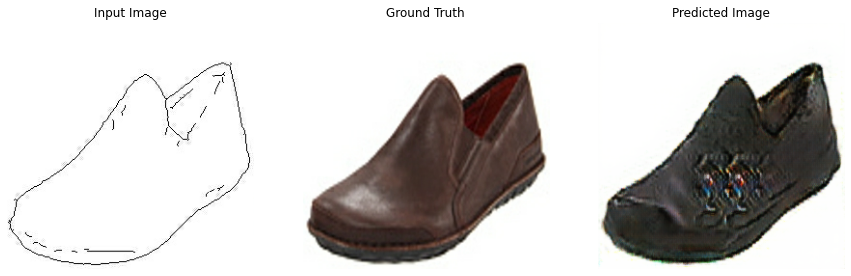

Epoch:  100
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 101 is 108.56298637390137 sec



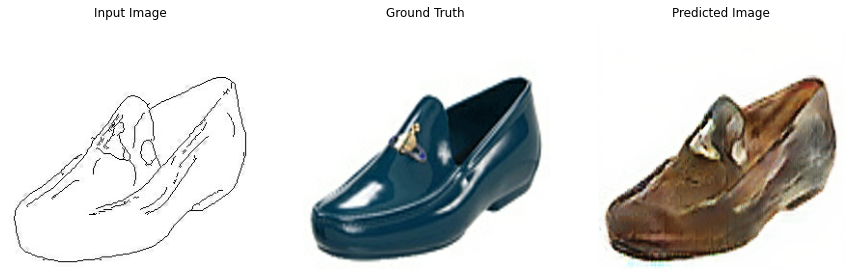

Epoch:  101
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 102 is 108.41613602638245 sec



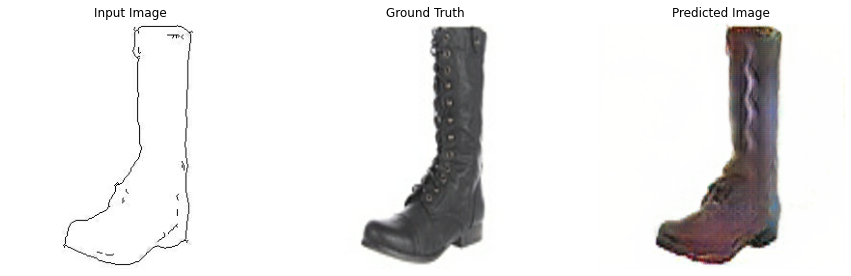

Epoch:  102
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 103 is 108.07540583610535 sec



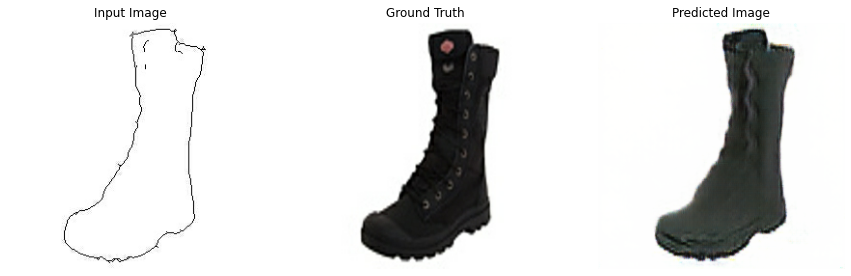

Epoch:  103
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 104 is 108.02486562728882 sec



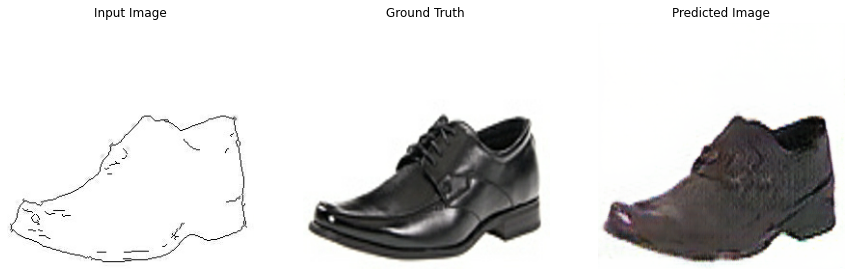

Epoch:  104
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 105 is 107.78141570091248 sec



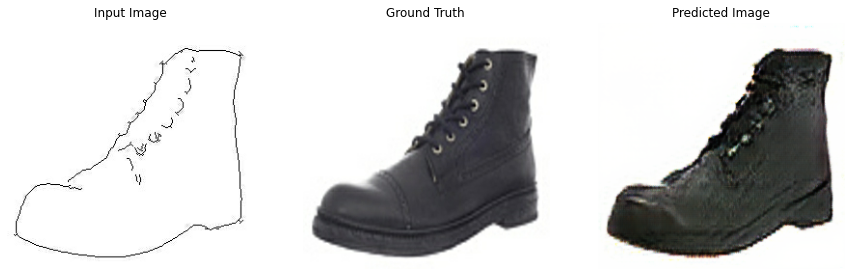

Epoch:  105
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 106 is 108.25852823257446 sec



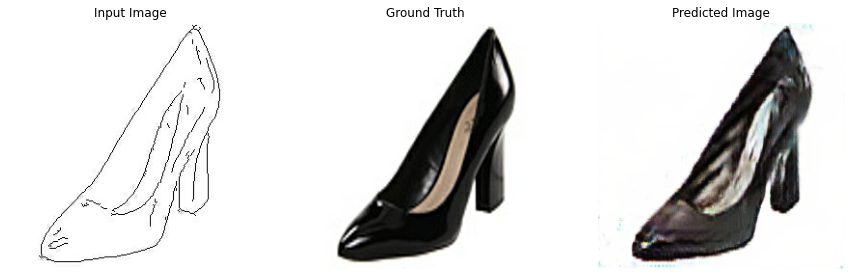

Epoch:  106
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 107 is 108.27498269081116 sec



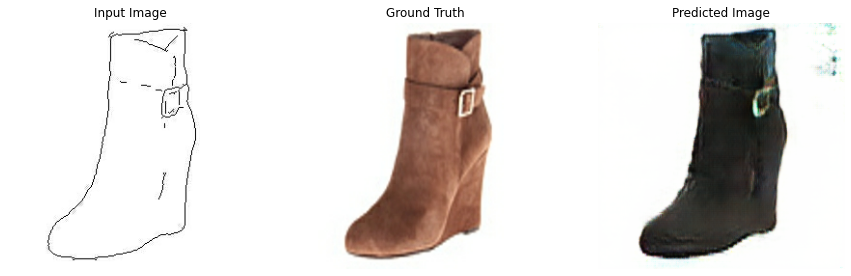

Epoch:  107
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 108 is 108.19968485832214 sec



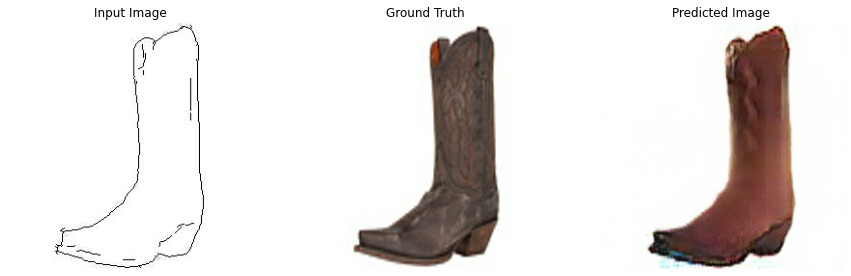

Epoch:  108
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 109 is 108.34782004356384 sec



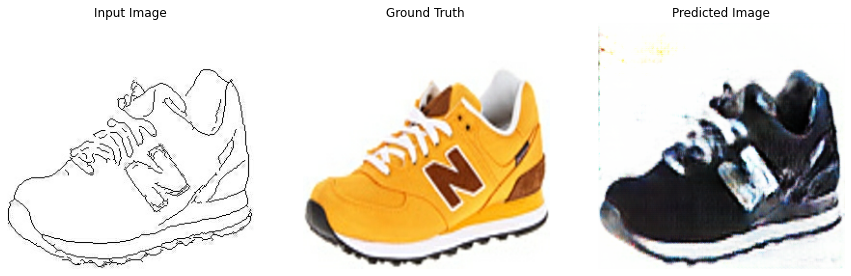

Epoch:  109
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 110 is 108.26036024093628 sec



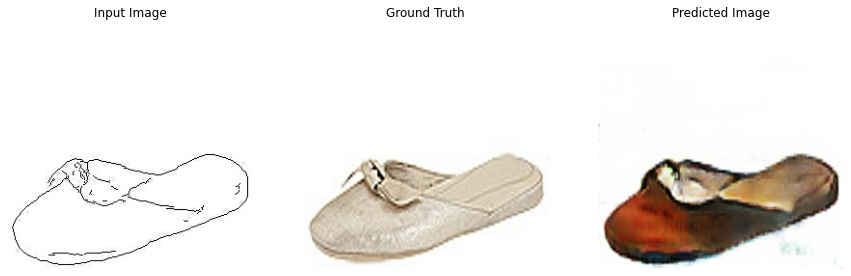

Epoch:  110
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 111 is 108.09847164154053 sec



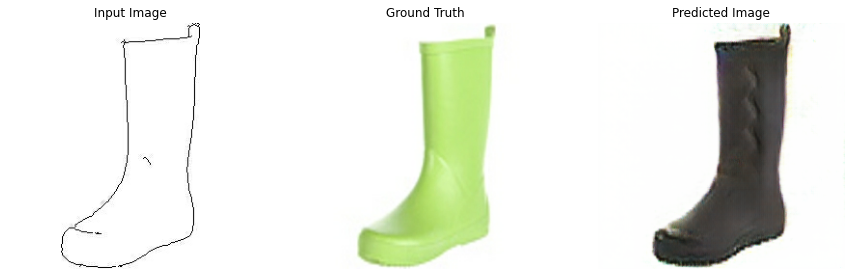

Epoch:  111
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 112 is 108.14636206626892 sec



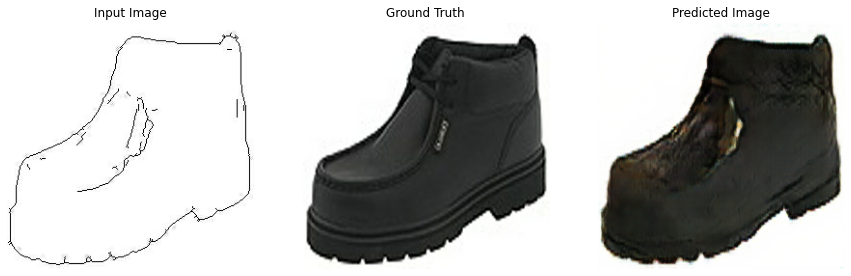

Epoch:  112
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 113 is 108.55636024475098 sec



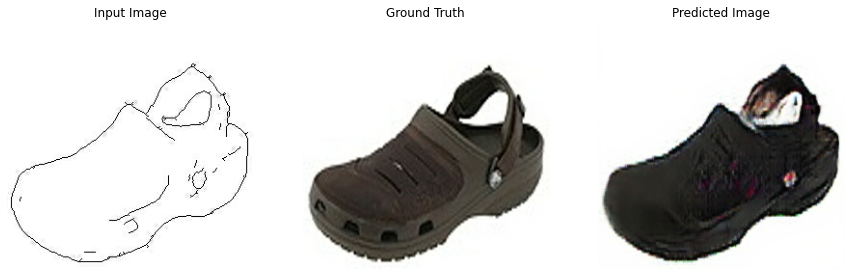

Epoch:  113
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 114 is 108.15934371948242 sec



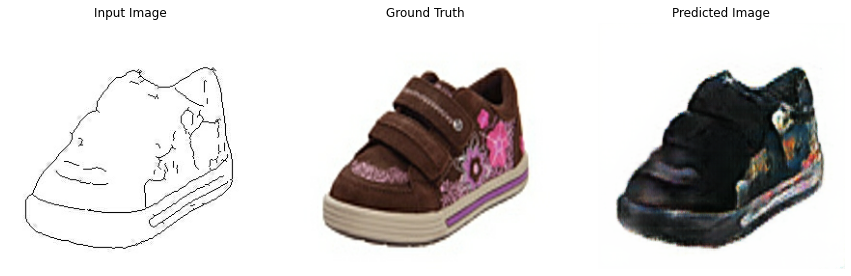

Epoch:  114
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 115 is 108.08817982673645 sec



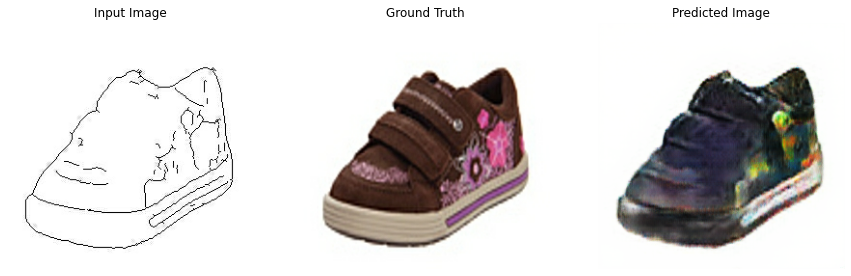

Epoch:  115
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 116 is 108.19430160522461 sec



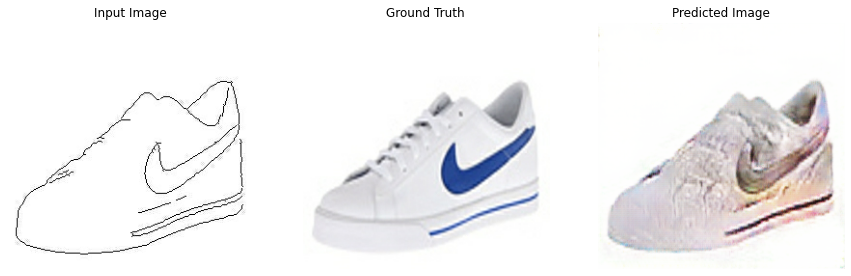

Epoch:  116
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 117 is 108.632976770401 sec



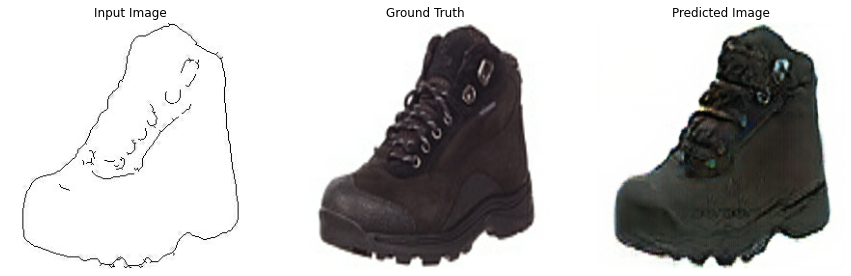

Epoch:  117
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 118 is 108.06009554862976 sec



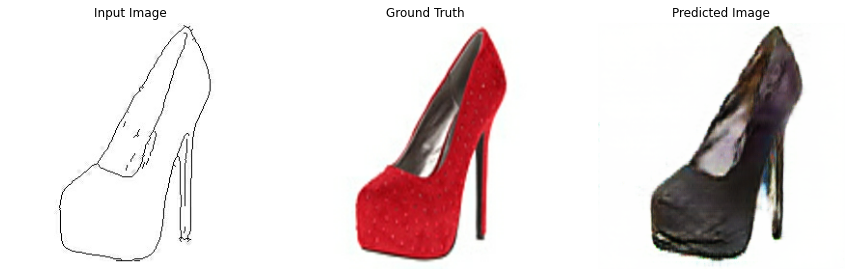

Epoch:  118
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 119 is 108.39389109611511 sec



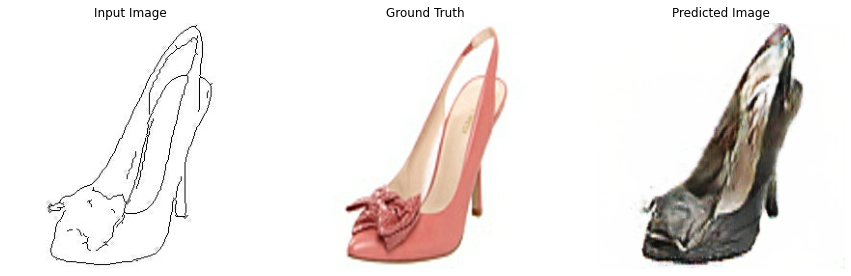

Epoch:  119
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 120 is 110.73646640777588 sec



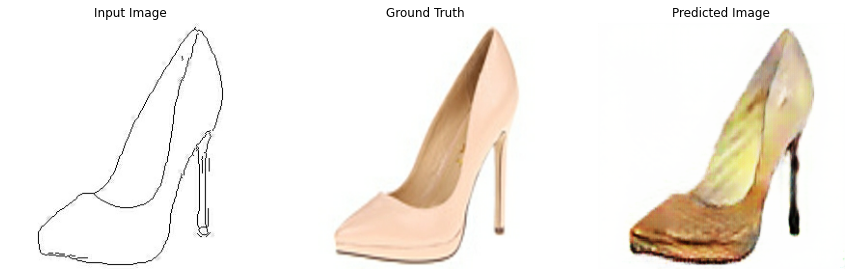

Epoch:  120
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 121 is 108.14352536201477 sec



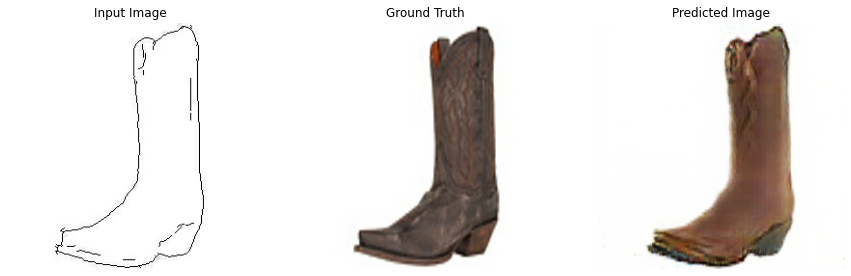

Epoch:  121
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 122 is 108.02608323097229 sec



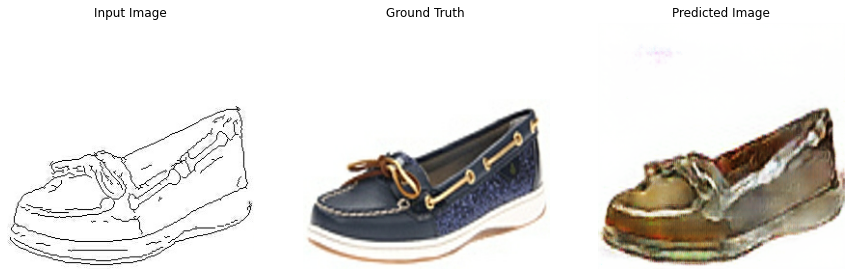

Epoch:  122
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 123 is 108.01327133178711 sec



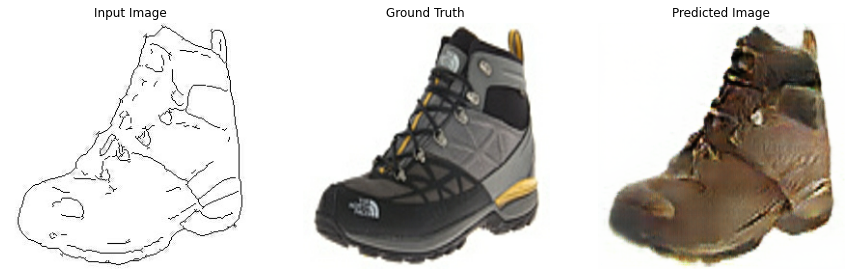

Epoch:  123
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 124 is 108.38960361480713 sec



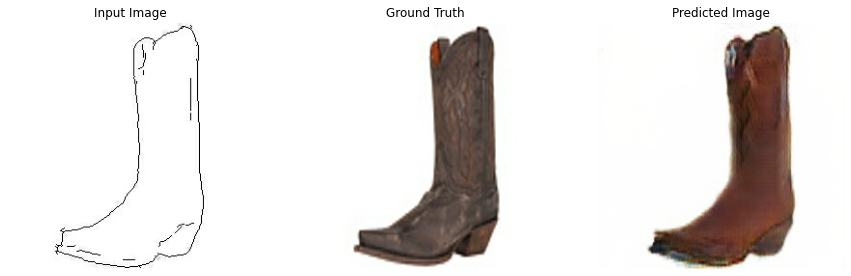

Epoch:  124
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 125 is 107.73888421058655 sec



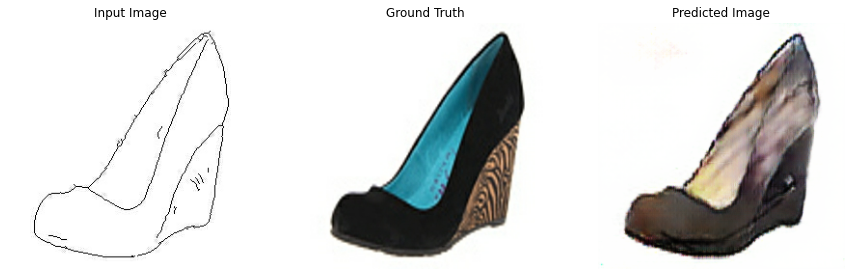

Epoch:  125
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 126 is 108.41439318656921 sec



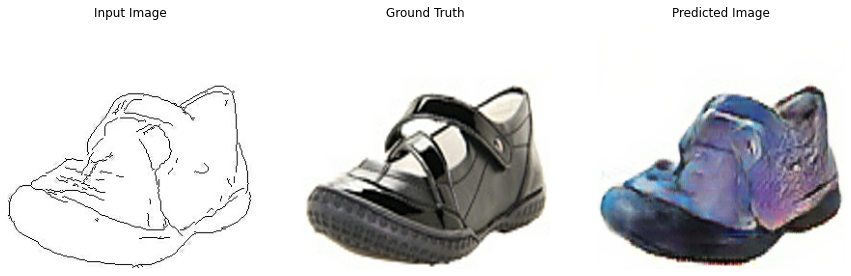

Epoch:  126
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 127 is 108.3414478302002 sec



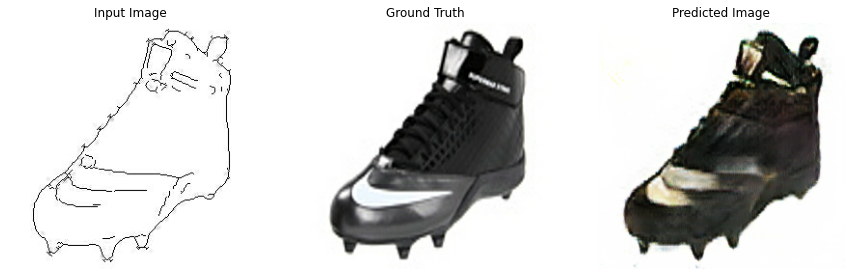

Epoch:  127
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 128 is 108.53581690788269 sec



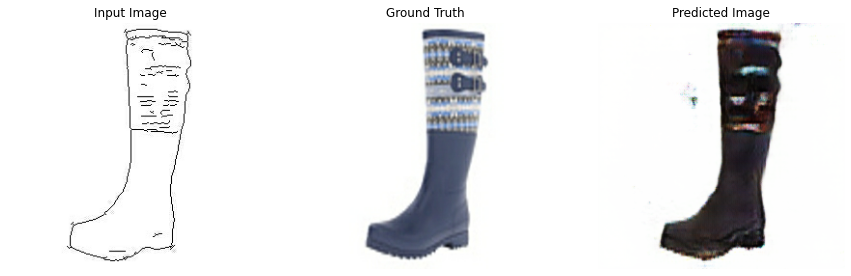

Epoch:  128
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 129 is 108.32017302513123 sec



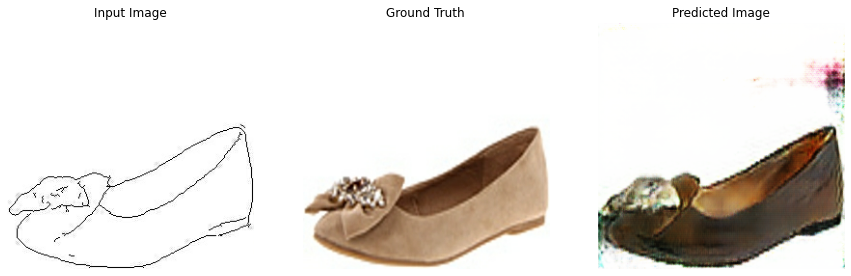

Epoch:  129
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 130 is 108.12635064125061 sec



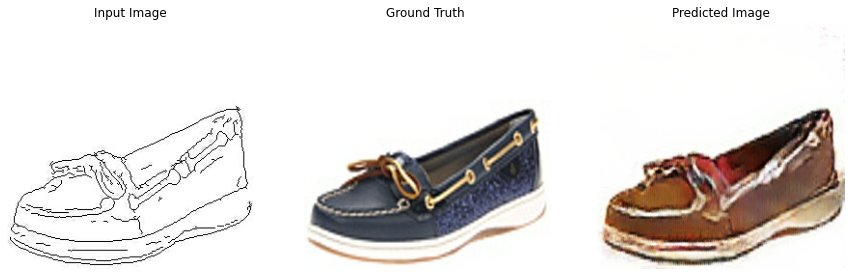

Epoch:  130
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 131 is 108.14075875282288 sec



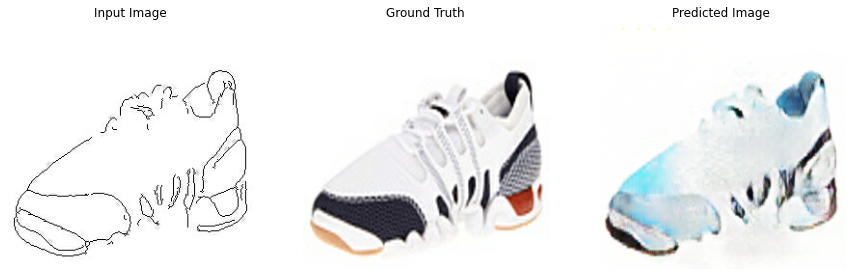

Epoch:  131
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 132 is 108.5050220489502 sec



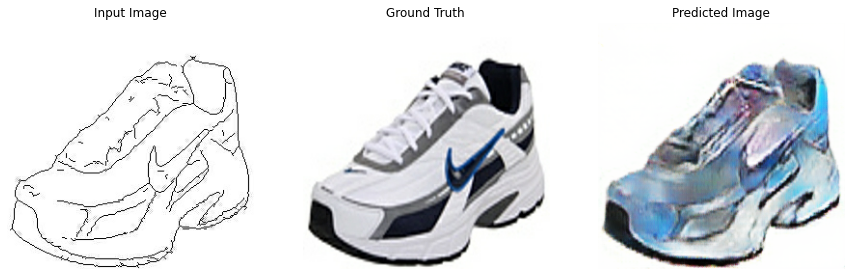

Epoch:  132
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 133 is 108.35912680625916 sec



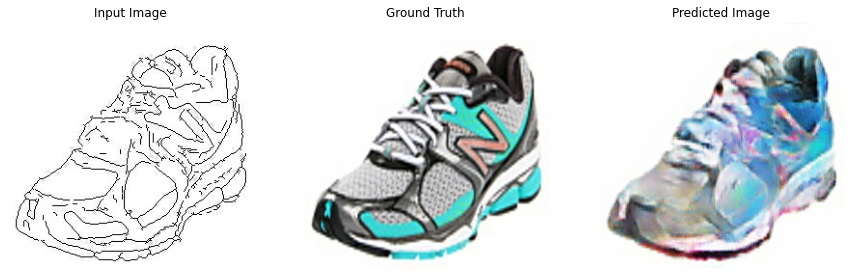

Epoch:  133
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 134 is 108.51710510253906 sec



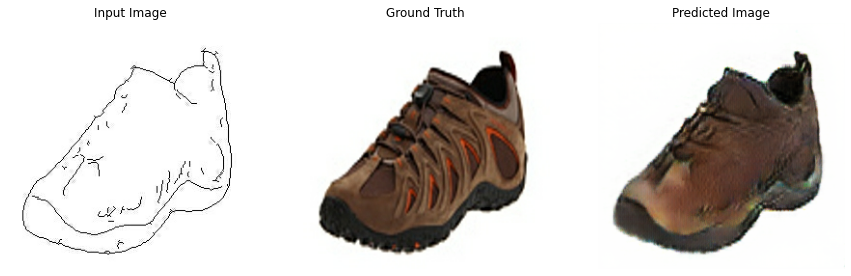

Epoch:  134
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 135 is 108.14685273170471 sec



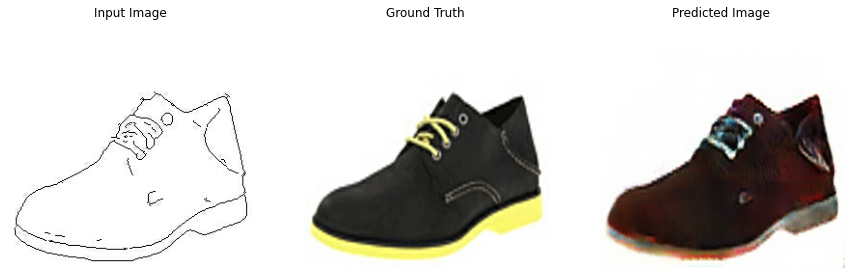

Epoch:  135
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 136 is 108.23337292671204 sec



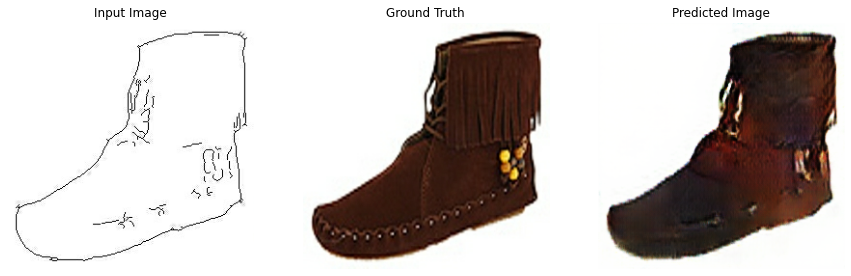

Epoch:  136
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 137 is 108.25070476531982 sec



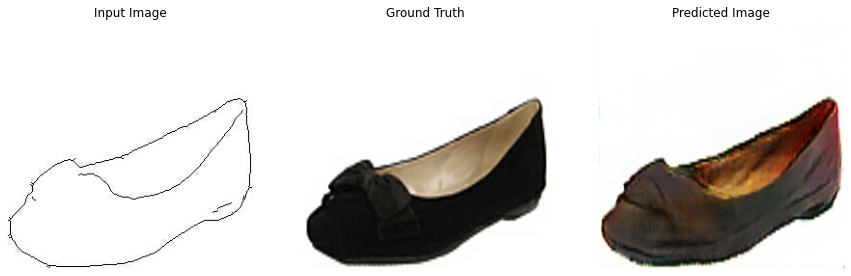

Epoch:  137
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 138 is 108.3453049659729 sec



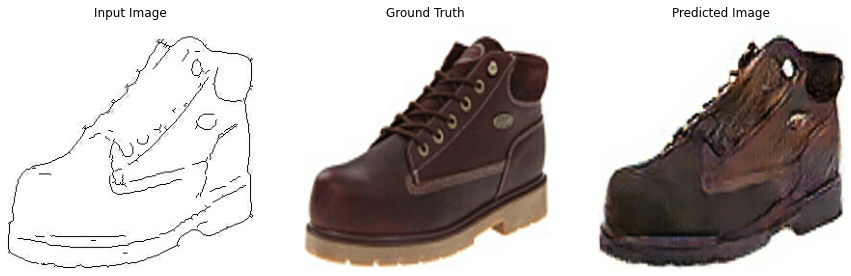

Epoch:  138
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 139 is 108.4911596775055 sec



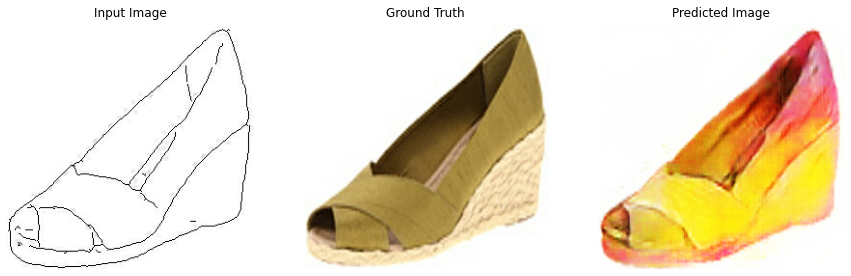

Epoch:  139
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 140 is 111.51666855812073 sec



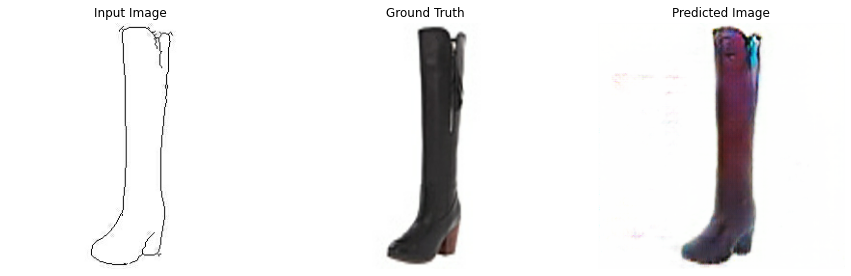

Epoch:  140
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 141 is 108.3605146408081 sec



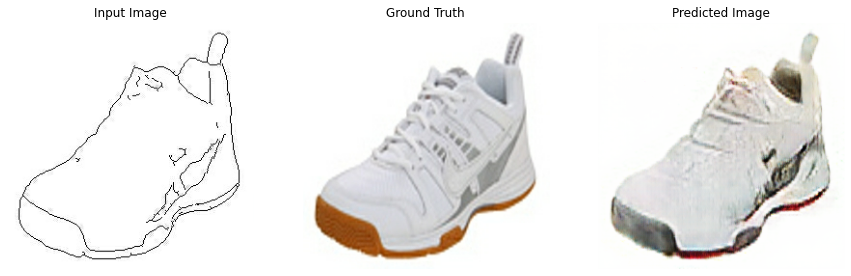

Epoch:  141
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 142 is 108.30019068717957 sec



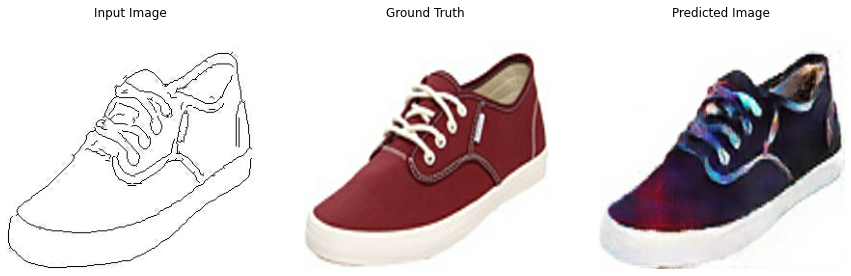

Epoch:  142
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 143 is 108.51233744621277 sec



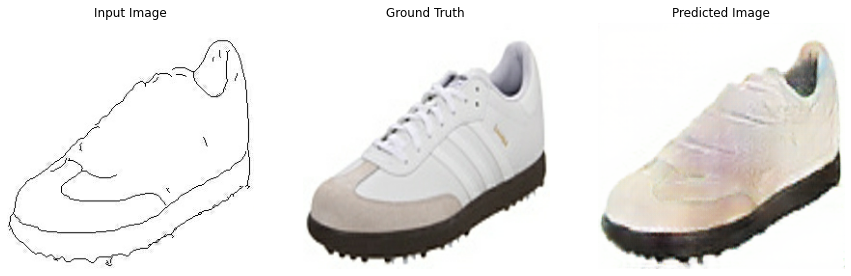

Epoch:  143
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 144 is 108.2616834640503 sec



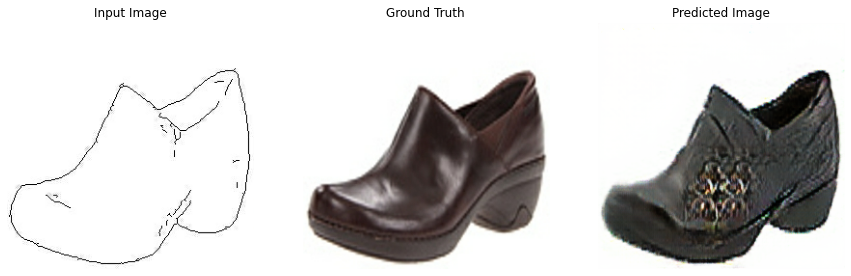

Epoch:  144
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 145 is 108.62290573120117 sec



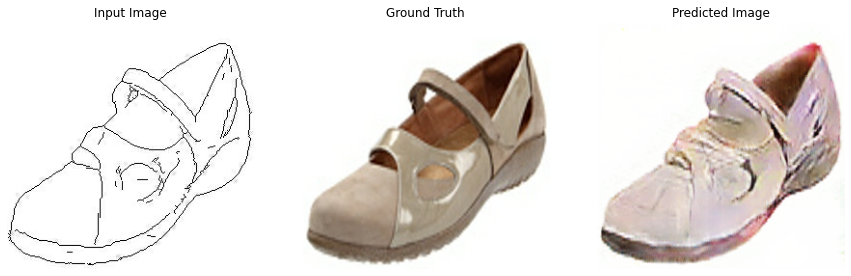

Epoch:  145
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 146 is 108.48710465431213 sec



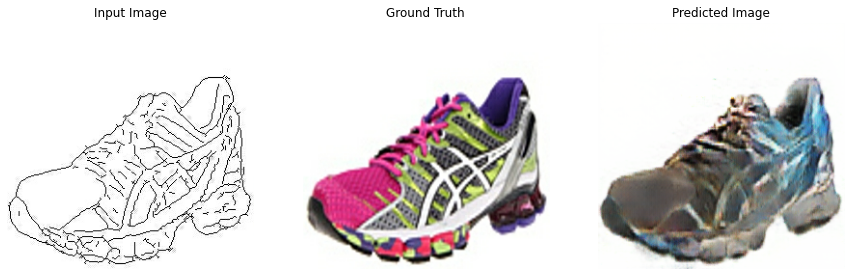

Epoch:  146
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 147 is 108.45309257507324 sec



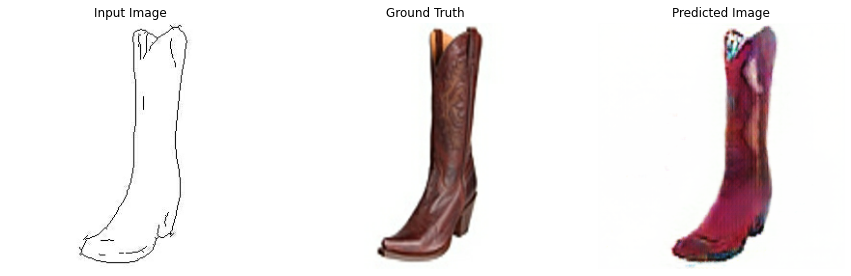

Epoch:  147
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 148 is 108.2243230342865 sec



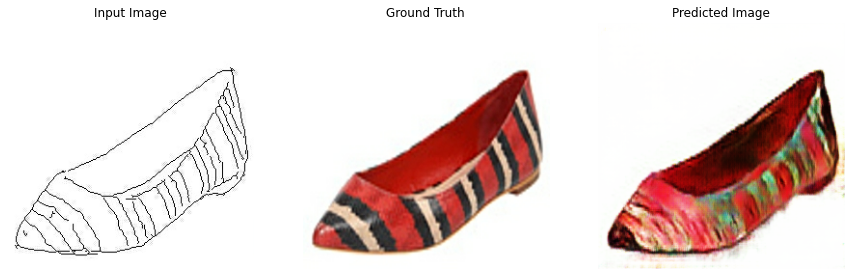

Epoch:  148
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 149 is 108.561368227005 sec



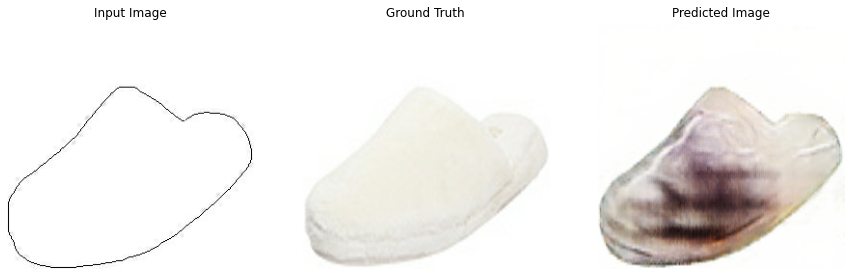

Epoch:  149
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.........................
Time taken for epoch 150 is 108.6737425327301 sec



In [38]:
fit(train_dataset, EPOCHS, test_dataset)

**Saving the Model**

In [39]:
generator.save(f"saved_model/{subject}_fully_trained.h5")

**Testing on your own images**

Loaded (1, 256, 256, 3)
Loaded (256, 256, 3)


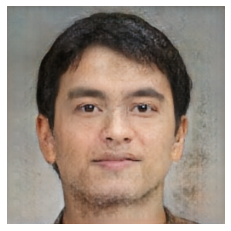

In [14]:
from keras.models import load_model
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img
from numpy import expand_dims
from matplotlib import pyplot
import tensorflow as tf

def load_image(filename, size=(256,256)):
    # load image with the preferred size
    pixels = load_img(filename, target_size=size)
    # convert to numpy array
    pixels = img_to_array(pixels)
    # scale from [0,255] to [-1,1]
    pixels = (pixels - 127.5) / 127.5
    # reshape to 1 sample
    pixels = expand_dims(pixels, 0)
    return pixels


src_image = load_image('test.png')
print('Loaded', src_image.shape)
# load model
model = load_model('saved_model/humans_fully_trained.h5')

# generate image from source
gen_image = model.predict(src_image)

gen_image = tf.reshape(gen_image, [256, 256, 3])
# scale from [-1,1] to [0,1]
gen_image = (gen_image + 1) / 2.0
print('Loaded', gen_image.shape)
# plot the image
pyplot.imshow(gen_image)
pyplot.axis('off')
pyplot.show()

In [5]:
gen_image

<tf.Tensor: shape=(256, 256, 3), dtype=float32, numpy=
array([[[0.5201211 , 0.4954591 , 0.4793156 ],
        [0.47335652, 0.45617744, 0.43203354],
        [0.48633915, 0.46513212, 0.44530916],
        ...,
        [0.4716519 , 0.44359055, 0.41359776],
        [0.45293647, 0.42738235, 0.38903016],
        [0.5024682 , 0.4664185 , 0.4367315 ]],

       [[0.50086826, 0.46831277, 0.4447804 ],
        [0.46021906, 0.45239702, 0.4244349 ],
        [0.47654217, 0.47025645, 0.4448194 ],
        ...,
        [0.4787276 , 0.46059746, 0.4258555 ],
        [0.44708738, 0.42077813, 0.38836408],
        [0.45258203, 0.41339725, 0.3765475 ]],

       [[0.49960756, 0.4682168 , 0.45114937],
        [0.46868452, 0.4667724 , 0.45432428],
        [0.48463324, 0.481913  , 0.47355515],
        ...,
        [0.48455077, 0.47252673, 0.45662642],
        [0.45595843, 0.44007042, 0.41602367],
        [0.44577312, 0.4272985 , 0.39087117]],

       ...,

       [[0.64716333, 0.63641775, 0.6266351 ],
        [0.66

In [18]:
pixels = load_img('test.png', target_size=(256,256))
pixels = img_to_array(pixels)
print(pixels.shape)
pixels

(256, 256, 3)


array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       ...,

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]]], dtype=float32)

In [16]:
src_image.shape

(1, 256, 256, 3)

In [4]:
img_to_array(gen_image)

array([[[0.5201211 , 0.4954591 , 0.4793156 ],
        [0.47335652, 0.45617744, 0.43203354],
        [0.48633915, 0.46513212, 0.44530916],
        ...,
        [0.4716519 , 0.44359055, 0.41359776],
        [0.45293647, 0.42738235, 0.38903016],
        [0.5024682 , 0.4664185 , 0.4367315 ]],

       [[0.50086826, 0.46831277, 0.4447804 ],
        [0.46021906, 0.45239702, 0.4244349 ],
        [0.47654217, 0.47025645, 0.4448194 ],
        ...,
        [0.4787276 , 0.46059746, 0.4258555 ],
        [0.44708738, 0.42077813, 0.38836408],
        [0.45258203, 0.41339725, 0.3765475 ]],

       [[0.49960756, 0.4682168 , 0.45114937],
        [0.46868452, 0.4667724 , 0.45432428],
        [0.48463324, 0.481913  , 0.47355515],
        ...,
        [0.48455077, 0.47252673, 0.45662642],
        [0.45595843, 0.44007042, 0.41602367],
        [0.44577312, 0.4272985 , 0.39087117]],

       ...,

       [[0.64716333, 0.63641775, 0.6266351 ],
        [0.66191816, 0.6537544 , 0.6372025 ],
        [0.6718834 , 0

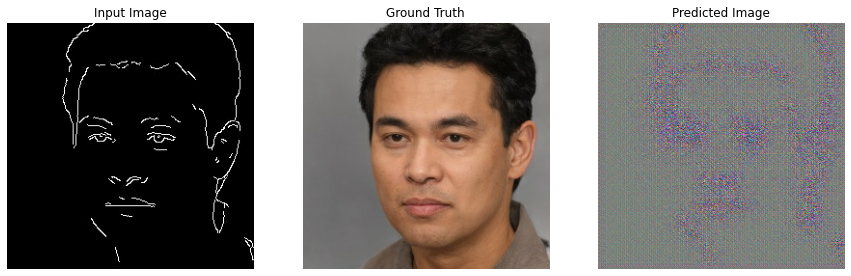

In [67]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target, epoch=-1)